## Question 3 : Camera Calibration

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import sys
import glob
import json

In [2]:
def question_3(path, json_path):    
    corners_per_row = 8
    corners_per_col = 6
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    objp2 = np.array([[[i, j, 0] for j in range(corners_per_col) for i in range(corners_per_row)]], dtype=np.float32)

    objectPoints = []
    imagePoints = []
    imageProjPoints = []

    images_path = sorted(glob.glob(path), key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('_')[-1]))

    for idx, image_path in enumerate(images_path):
        print(f"Image path: {image_path}")
        image = cv2.imread(image_path)
        grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        retval, corners = cv2.findChessboardCorners(grayscale_image, (corners_per_row, corners_per_col), cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_FAST_CHECK + cv2.CALIB_CB_NORMALIZE_IMAGE)
        print(f"Image {idx + 1}: {retval}")

        if retval:
            objectPoints.append(objp2)
            refined_corners = cv2.cornerSubPix(grayscale_image, corners, (11, 11), (-1, -1), criteria)
            imagePoints.append(refined_corners)

            # cv2.drawChessboardCorners(image, (corners_per_row, corners_per_col), refined_corners, retval)
            # cv2.namedWindow('Corners', cv2.WINDOW_NORMAL)
            # cv2.imshow('Corners', image)
            # cv2.waitKey(0)
            # output_path = os.path.join('corners_output', f'corners_{idx + 1}.jpg')
            # cv2.imwrite(output_path, image)

    cv2.destroyAllWindows()

    retval, camera_matrix, distortion_coefficients, rotation_vectors, translation_vectors = cv2.calibrateCamera(objectPoints, imagePoints, grayscale_image.shape[::-1], None, None)
    print("\nCamera matrix : ", camera_matrix)
    print("\nDistortion coefficients : ", distortion_coefficients)
    print("\nRotation Vectors : ", rotation_vectors)
    print("\nTranslation Vectors : ", translation_vectors)

    errors = []

    for i in range(len(objectPoints)):
        image_proj, _ = cv2.projectPoints(objectPoints[i], rotation_vectors[i], translation_vectors[i], camera_matrix, distortion_coefficients)
        imageProjPoints.append(image_proj)
        error = cv2.norm(imagePoints[i], image_proj, cv2.NORM_L2)/len(image_proj)
        errors.append(error)

    print("\nMean error: ", np.mean(errors))
    print("\nStandard deviation of error: ", np.std(errors))

    intrinsic_parameters = {
        "focal_length" : [camera_matrix[0][0], camera_matrix[1][1]],
        "skew" : camera_matrix[0][1],
        "principal_point" : [camera_matrix[0][2], camera_matrix[1][2]]
    }
    print("\nIntrinsic parameters: ", intrinsic_parameters)

    extrinsic_parameters = [{
        "image_id": i+1,
        "rotation_matrix": cv2.Rodrigues(rotation_vectors[i])[0].tolist(),
        "translation_vector": translation_vectors[i].flatten().tolist()
    } for i in range(len(objectPoints))]

    print("\nExtrinsic parameters: ", extrinsic_parameters)

    radial_distortion_coefficients = [distortion_coefficients[0][0], distortion_coefficients[0][1], distortion_coefficients[0][4]] # k1, k2, k3
    print("\nRadial distortion coefficients: ", radial_distortion_coefficients)

    reprojection_errors = {
        "mean_error": np.mean(errors),
        "std_dev": np.std(errors)
    }
    print("\nReprojection errors: ", reprojection_errors)


    output = {
        "intrinsic_parameters": intrinsic_parameters,
        "extrinsic_parameters": extrinsic_parameters[:2],
        "radial_distortion_coefficients": radial_distortion_coefficients,
        "reprojection_errors": reprojection_errors
    }

    with open(json_path, 'w') as json_file:
        json.dump(output, json_file, indent=4)
    print(f"\nCamera calibration parameters saved to {json_path}")

    return camera_matrix, distortion_coefficients, rotation_vectors, translation_vectors, errors, intrinsic_parameters, extrinsic_parameters, radial_distortion_coefficients, reprojection_errors, objectPoints, imagePoints, imageProjPoints

Camera Calibration on given dataset

In [3]:
camera_matrix, distortion_coefficients, rotation_vectors, translation_vectors, errors, intrinsic_parameters, extrinsic_parameters, radial_distortion_coefficients, reprojection_errors, objectPoints, imagePoints, imageProjPoints = question_3('chessboard_dataset/*.jpeg', '2022482_parameters.json')

Image path: chessboard_dataset\1.jpeg
Image 1: True
Image path: chessboard_dataset\2.jpeg
Image 2: True
Image path: chessboard_dataset\3.jpeg
Image 3: True
Image path: chessboard_dataset\4.jpeg
Image 4: True
Image path: chessboard_dataset\5.jpeg
Image 5: True
Image path: chessboard_dataset\6.jpeg
Image 6: True
Image path: chessboard_dataset\7.jpeg
Image 7: True
Image path: chessboard_dataset\8.jpeg
Image 8: True
Image path: chessboard_dataset\9.jpeg
Image 9: True
Image path: chessboard_dataset\10.jpeg
Image 10: True
Image path: chessboard_dataset\11.jpeg
Image 11: True
Image path: chessboard_dataset\12.jpeg
Image 12: True
Image path: chessboard_dataset\13.jpeg
Image 13: True
Image path: chessboard_dataset\14.jpeg
Image 14: True
Image path: chessboard_dataset\15.jpeg
Image 15: True
Image path: chessboard_dataset\16.jpeg
Image 16: True
Image path: chessboard_dataset\17.jpeg
Image 17: True
Image path: chessboard_dataset\18.jpeg
Image 18: True
Image path: chessboard_dataset\19.jpeg
Image 1

Camera Calibration on my dataset

In [4]:
my_camera_camera_matrix, my_camera_distortion_coefficients, my_camera_rotation_vectors, my_camera_translation_vectors, my_camera_errors, my_camera_intrinsic_parameters, my_camera_extrinsic_parameters, my_camera_radial_distortion_coefficients, my_camera_reprojection_errors, my_camera_objectPoints, my_camera_imagePoints, my_camera_imageProjPoints = question_3('shobhit_checkerboard_patterns/*.jpg', '2022482_my_camera_parameters.json')

Image path: shobhit_checkerboard_patterns\1.jpg
Image 1: True
Image path: shobhit_checkerboard_patterns\2.jpg
Image 2: True
Image path: shobhit_checkerboard_patterns\3.jpg
Image 3: True
Image path: shobhit_checkerboard_patterns\4.jpg
Image 4: True
Image path: shobhit_checkerboard_patterns\5.jpg
Image 5: True
Image path: shobhit_checkerboard_patterns\6.jpg
Image 6: True
Image path: shobhit_checkerboard_patterns\7.jpg
Image 7: True
Image path: shobhit_checkerboard_patterns\8.jpg
Image 8: True
Image path: shobhit_checkerboard_patterns\9.jpg
Image 9: True
Image path: shobhit_checkerboard_patterns\10.jpg
Image 10: True
Image path: shobhit_checkerboard_patterns\11.jpg
Image 11: True
Image path: shobhit_checkerboard_patterns\12.jpg
Image 12: True
Image path: shobhit_checkerboard_patterns\13.jpg
Image 13: True
Image path: shobhit_checkerboard_patterns\14.jpg
Image 14: True
Image path: shobhit_checkerboard_patterns\15.jpg
Image 15: True
Image path: shobhit_checkerboard_patterns\16.jpg
Image 16:

Part 1

In [5]:
# Given dataset
focal_length_x, focal_length_y = intrinsic_parameters["focal_length"]
skew = intrinsic_parameters["skew"]
principal_point_x, principal_point_y = intrinsic_parameters["principal_point"]
mean_error = reprojection_errors["mean_error"]
std_dev = reprojection_errors["std_dev"]

print("Estimated intrinsic camera parameters on given dataset :-")
print(f"Focal lengths (fx, fy): ({focal_length_x}, {focal_length_y})")
print(f"Skew parameter: {skew}")
print(f"Principal point (cx, cy): ({principal_point_x}, {principal_point_y})")

print(f"Mean reprojection error: {mean_error}")
print(f"Standard deviation of reprojection error: {std_dev}")

# My camera dataset
focal_length_x, focal_length_y = my_camera_intrinsic_parameters["focal_length"]
skew = my_camera_intrinsic_parameters["skew"]
principal_point_x, principal_point_y = my_camera_intrinsic_parameters["principal_point"]
mean_error = my_camera_reprojection_errors["mean_error"]
std_dev = my_camera_reprojection_errors["std_dev"]

print("\nEstimated intrinsic camera parameters on my camera dataset :-")
print(f"Focal lengths (fx, fy): ({focal_length_x}, {focal_length_y})")
print(f"Skew parameter: {skew}")
print(f"Principal point (cx, cy): ({principal_point_x}, {principal_point_y})")

print(f"Mean reprojection error: {mean_error}")
print(f"Standard deviation of reprojection error: {std_dev}")

Estimated intrinsic camera parameters on given dataset :-
Focal lengths (fx, fy): (956.6371992152974, 957.5514133936001)
Skew parameter: 0.0
Principal point (cx, cy): (369.05485490440975, 651.4141996846588)
Mean reprojection error: 0.06971439945721061
Standard deviation of reprojection error: 0.0232137908988232

Estimated intrinsic camera parameters on my camera dataset :-
Focal lengths (fx, fy): (905.4646036106618, 906.3595104429302)
Skew parameter: 0.0
Principal point (cx, cy): (646.5824182659627, 351.38411267388784)
Mean reprojection error: 0.08016655510531397
Standard deviation of reprojection error: 0.0279125166878781


Part 2

In [6]:
# Given dataset
print("Extrinsic parameters for first 2 images in given dataset :-")
for i in range(2):
    rotation_matrix = extrinsic_parameters[i]["rotation_matrix"]
    translation_vector = extrinsic_parameters[i]["translation_vector"]
    print(f"Image {i+1}:")
    print("Rotation matrix:")
    for row in rotation_matrix:
        print(row)
    print(f"Translation vector: {translation_vector}")

# My camera dataset
print("\nExtrinsic parameters for first 2 images in my camera dataset :-")
for i in range(2):
    rotation_matrix = my_camera_extrinsic_parameters[i]["rotation_matrix"]
    translation_vector = my_camera_extrinsic_parameters[i]["translation_vector"]
    print(f"Image {i+1}:")
    print("Rotation matrix:")
    for row in rotation_matrix:
        print(row)
    print(f"Translation vector: {translation_vector}")

Extrinsic parameters for first 2 images in given dataset :-
Image 1:
Rotation matrix:
[0.9969984729950256, 0.01387206432922359, -0.07616830493606234]
[-0.02511535422508049, 0.9885626996679808, -0.14870443102780156]
[0.07323430772346952, 0.1501710846215054, 0.9859439038382787]
Translation vector: [-3.938294773117426, -3.6171629626621766, 14.65911194291161]
Image 2:
Rotation matrix:
[0.8905216070799399, -0.2419497797409265, -0.38526818115058287]
[0.12245551022949921, 0.943077372569933, -0.3092082103713046]
[0.43815056240771183, 0.22817838072418056, 0.869458861149794]
Translation vector: [-1.4977159344273927, -0.6579189965048309, 13.918170881468622]

Extrinsic parameters for first 2 images in my camera dataset :-
Image 1:
Rotation matrix:
[0.9985452130609608, 0.01792257135292904, -0.05085507751581579]
[-0.009972010809026714, 0.9882556501632911, 0.15248386446032738]
[0.05299072063545768, -0.15175490554321466, 0.9869966728262588]
Translation vector: [-3.8254901101610908, -3.04990262863487, 

Part 3


Radial distortion coefficients for given dataset:
k1: 0.19763718893269
k2: -0.7068699101326525
k3: 0.04879647967785064

Radial distortion coefficients for my camera dataset:
k1: 0.07085530538231413
k2: -0.18753729275564698
k3: -0.0893752723610056

Image path: chessboard_dataset\1.jpeg


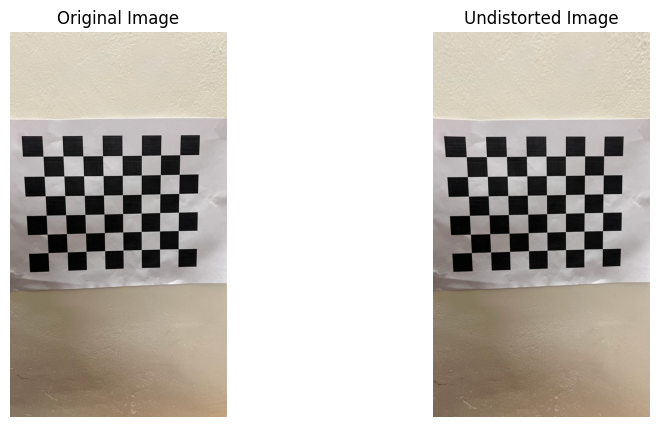

Image path: chessboard_dataset\2.jpeg


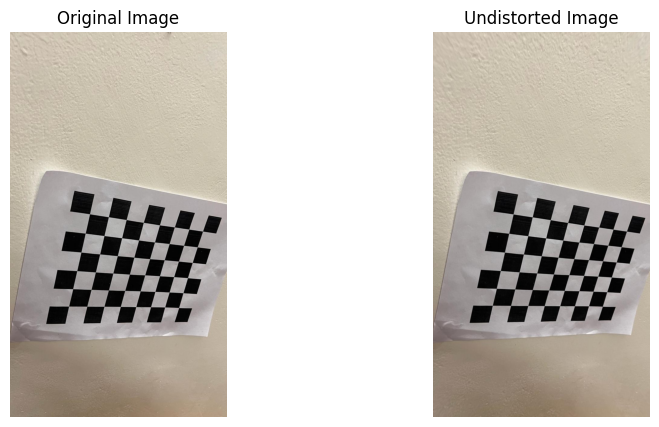

Image path: chessboard_dataset\3.jpeg


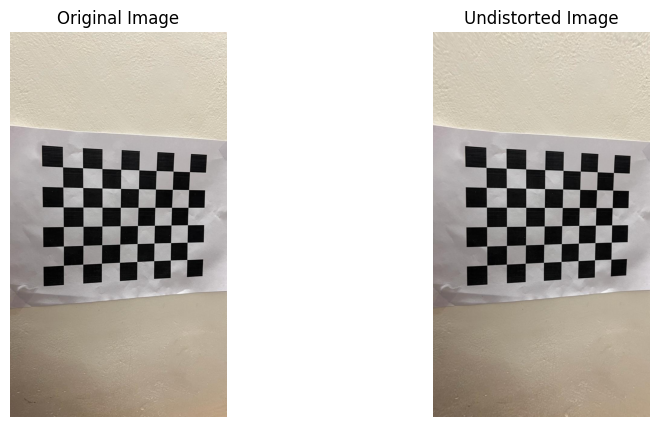

Image path: chessboard_dataset\4.jpeg


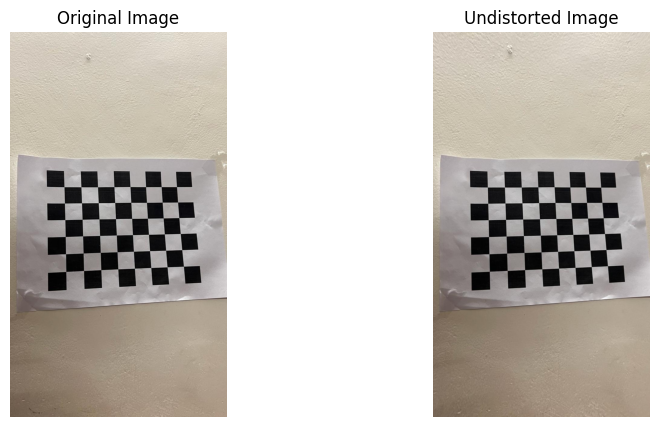

Image path: chessboard_dataset\5.jpeg


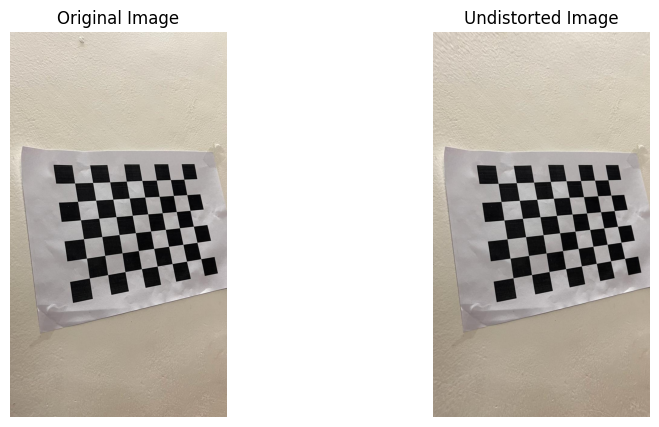

Image path: chessboard_dataset\6.jpeg


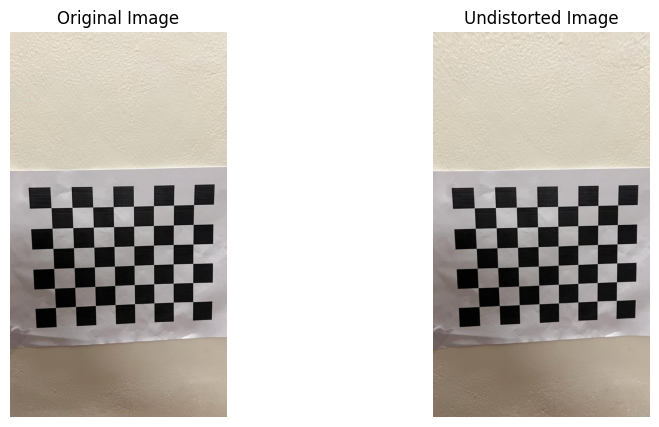

Image path: chessboard_dataset\7.jpeg


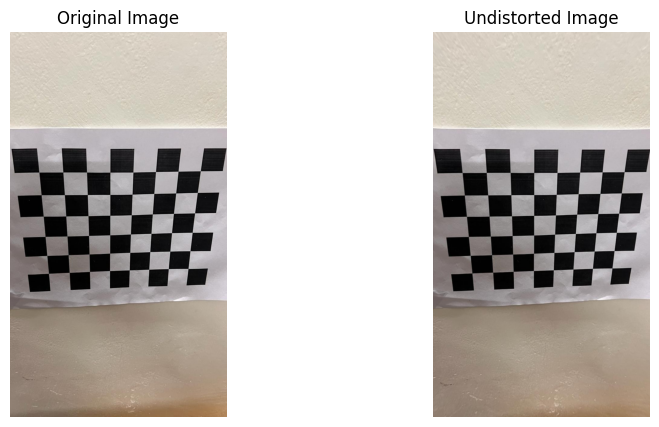

Image path: chessboard_dataset\8.jpeg


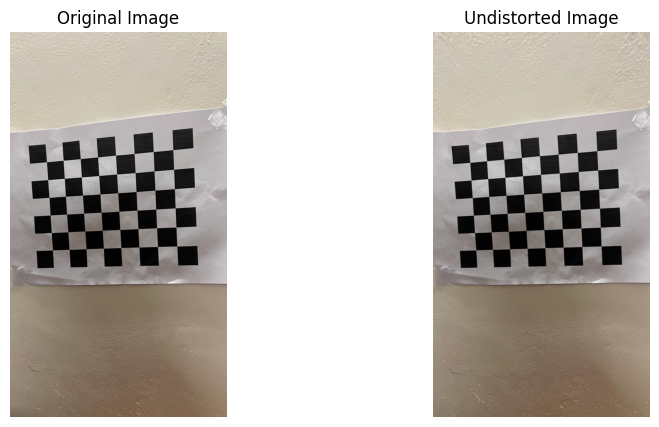

Image path: chessboard_dataset\9.jpeg


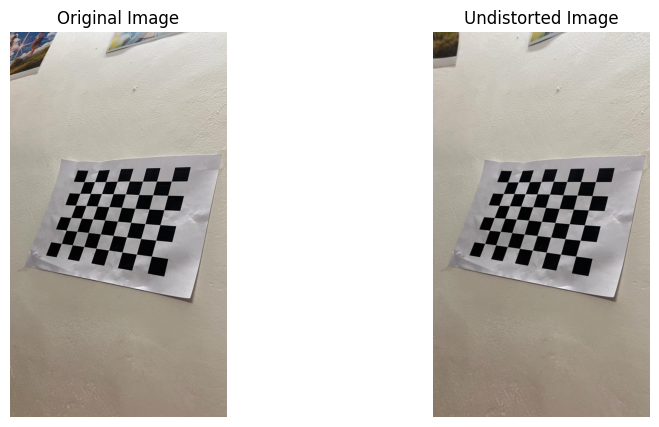

Image path: chessboard_dataset\10.jpeg


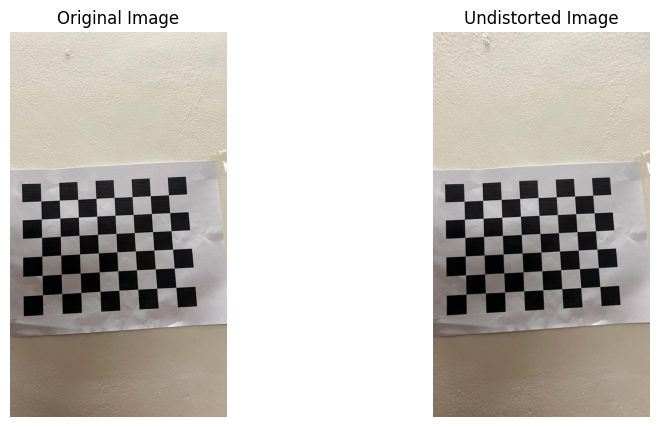

Image path: chessboard_dataset\11.jpeg


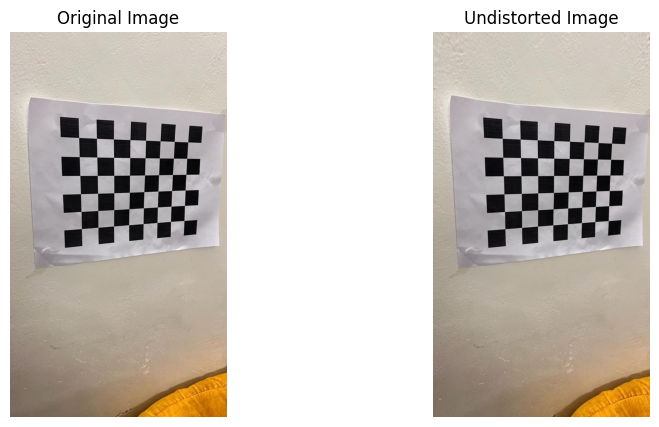

Image path: chessboard_dataset\12.jpeg


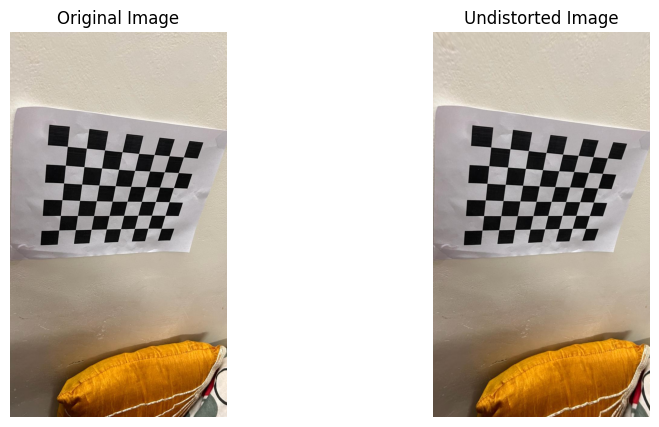

Image path: chessboard_dataset\13.jpeg


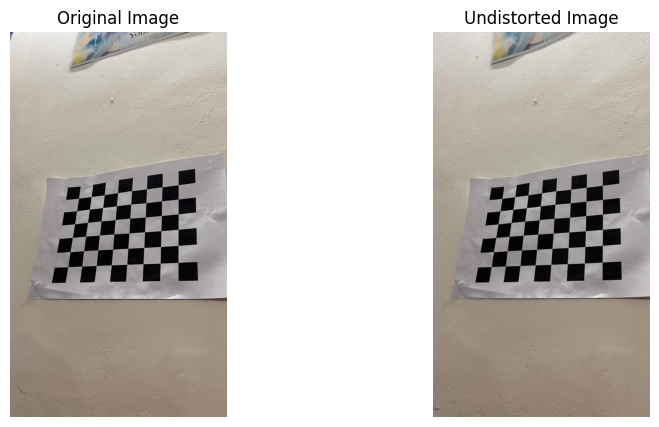

Image path: chessboard_dataset\14.jpeg


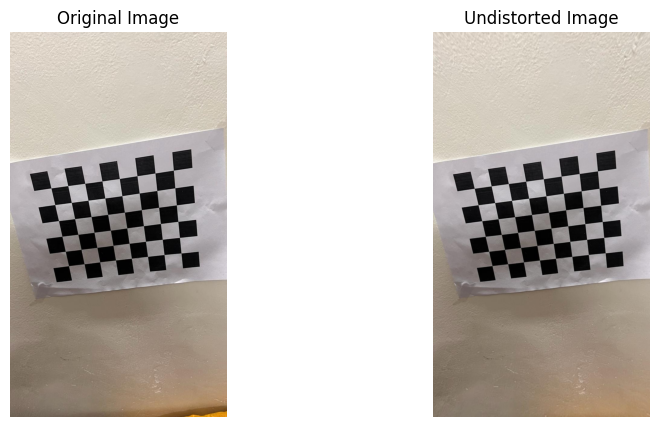

Image path: chessboard_dataset\15.jpeg


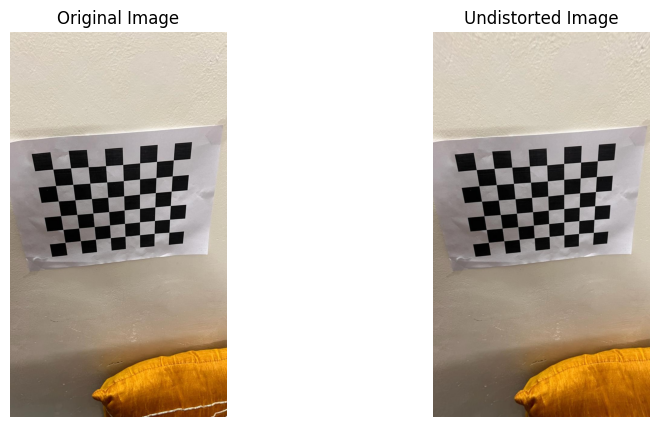

Image path: chessboard_dataset\16.jpeg


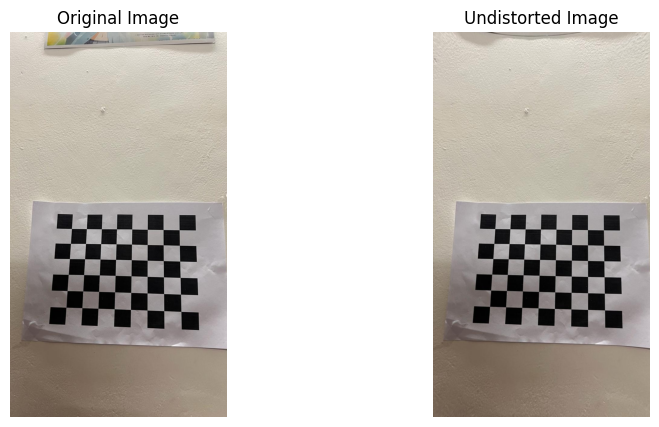

Image path: chessboard_dataset\17.jpeg


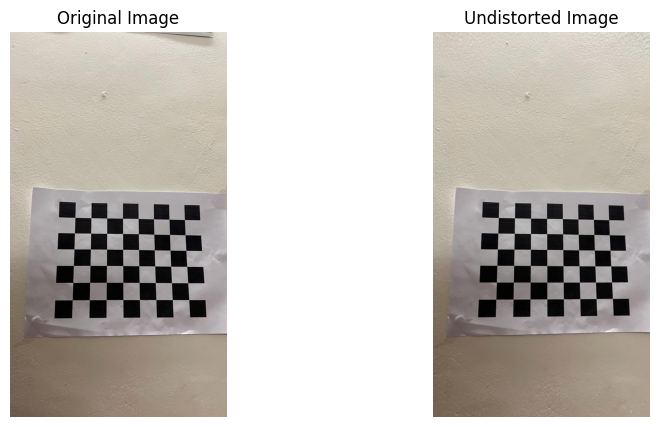

Image path: chessboard_dataset\18.jpeg


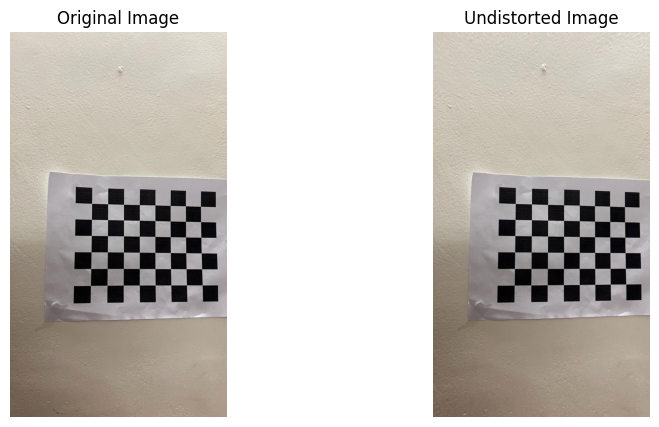

Image path: chessboard_dataset\19.jpeg


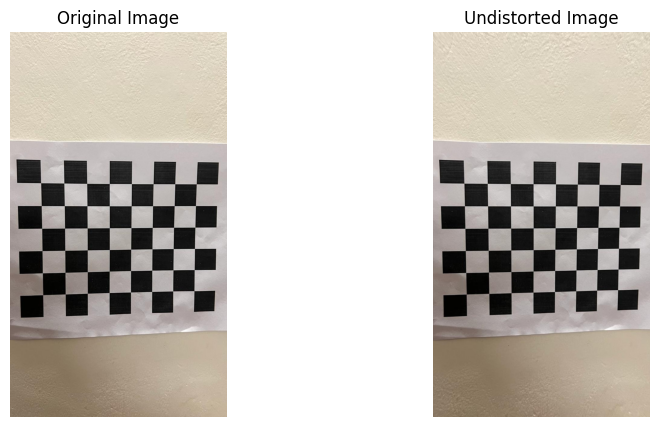

Image path: chessboard_dataset\20.jpeg


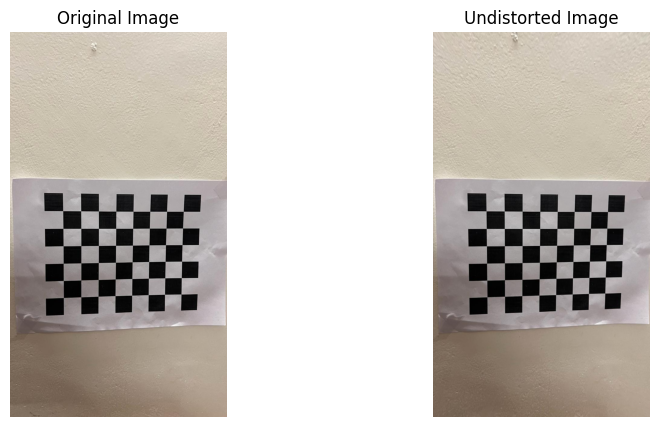

Image path: chessboard_dataset\21.jpeg


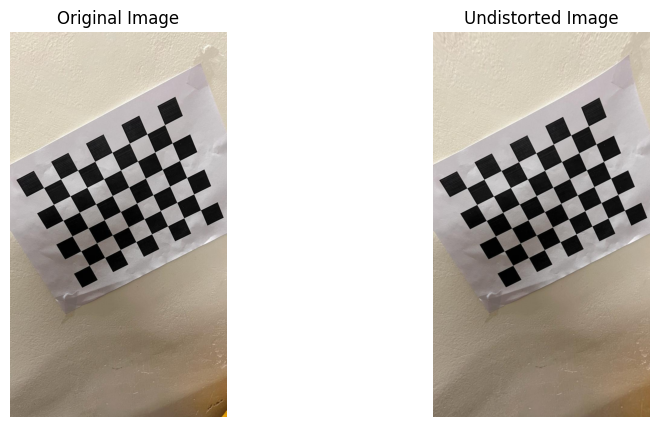

Image path: chessboard_dataset\22.jpeg


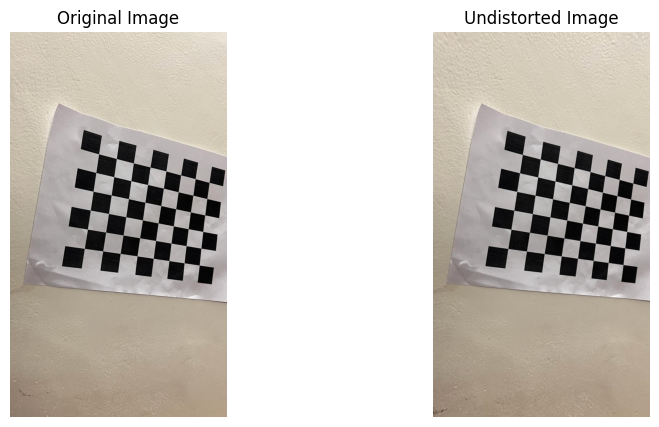

Image path: chessboard_dataset\23.jpeg


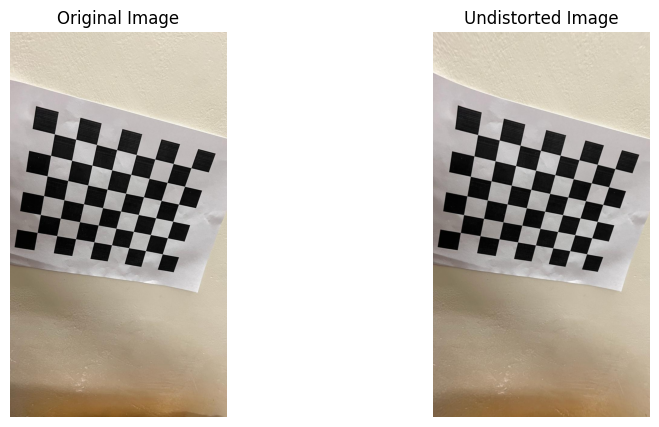

Image path: chessboard_dataset\24.jpeg


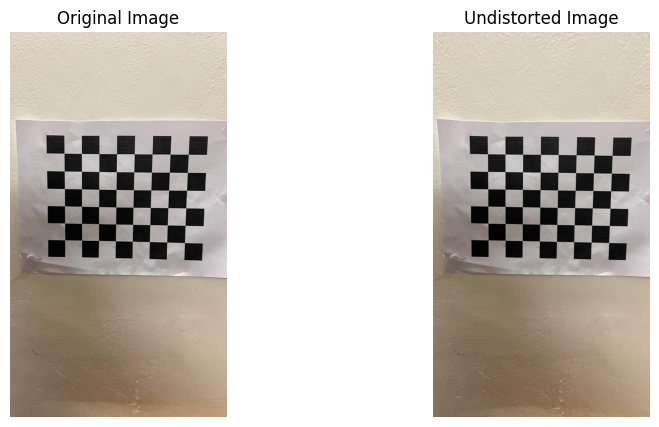

Image path: chessboard_dataset\25.jpeg


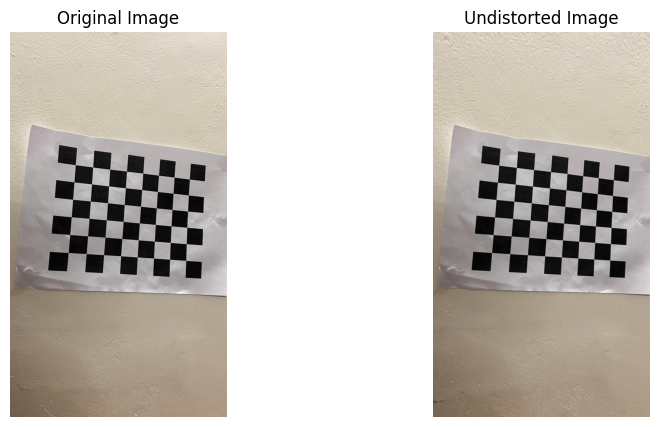

Image path: shobhit_checkerboard_patterns\1.jpg


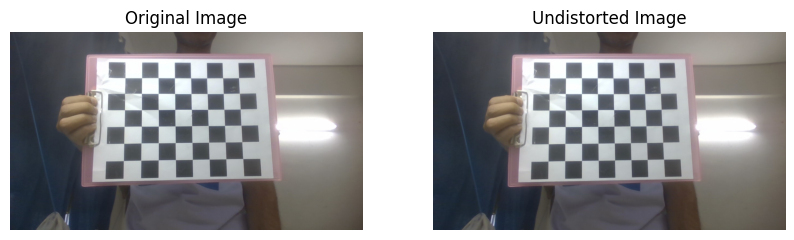

Image path: shobhit_checkerboard_patterns\2.jpg


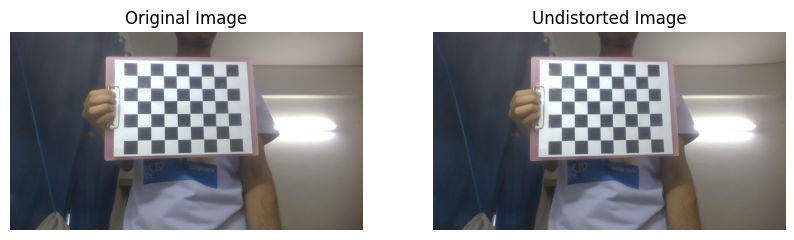

Image path: shobhit_checkerboard_patterns\3.jpg


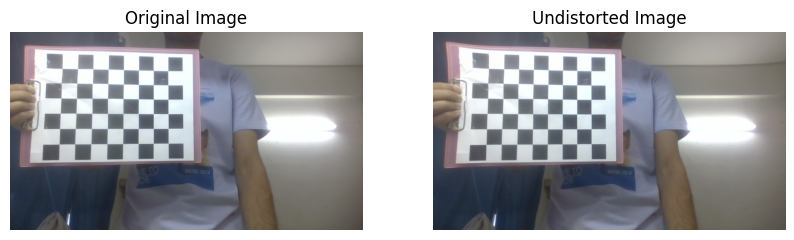

Image path: shobhit_checkerboard_patterns\4.jpg


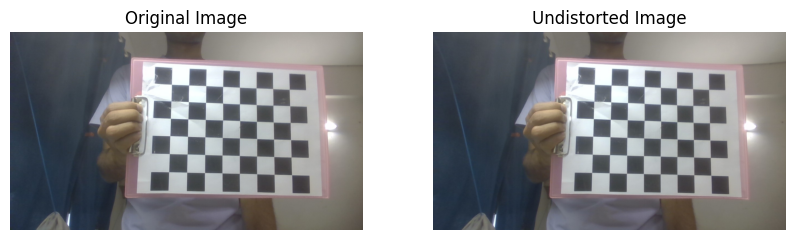

Image path: shobhit_checkerboard_patterns\5.jpg


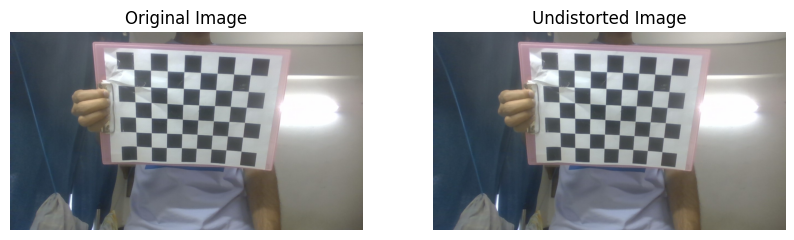

Image path: shobhit_checkerboard_patterns\6.jpg


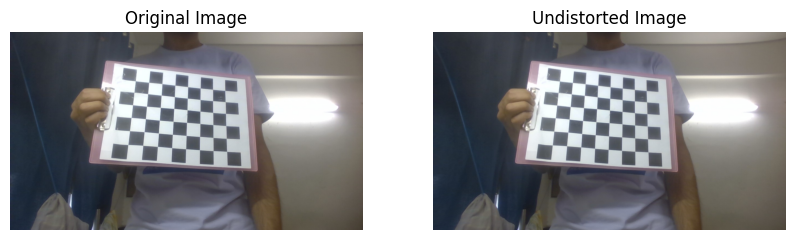

Image path: shobhit_checkerboard_patterns\7.jpg


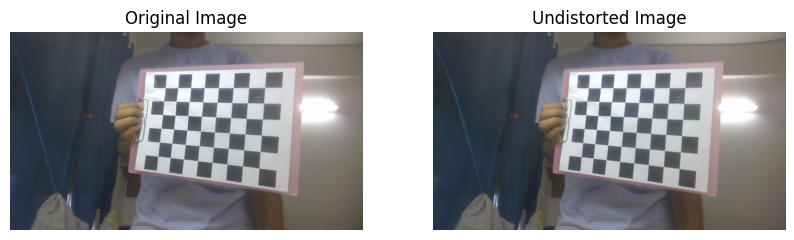

Image path: shobhit_checkerboard_patterns\8.jpg


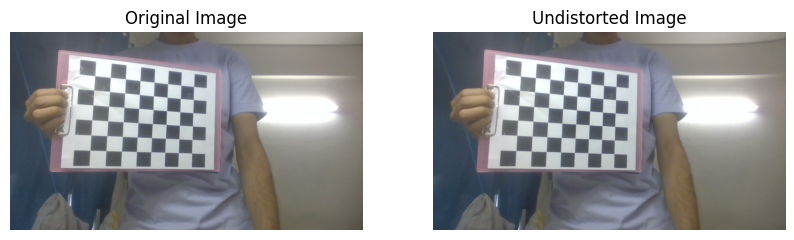

Image path: shobhit_checkerboard_patterns\9.jpg


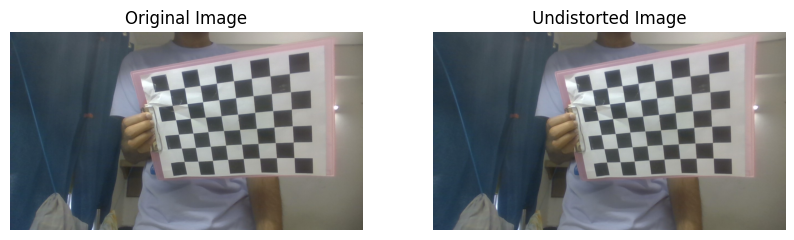

Image path: shobhit_checkerboard_patterns\10.jpg


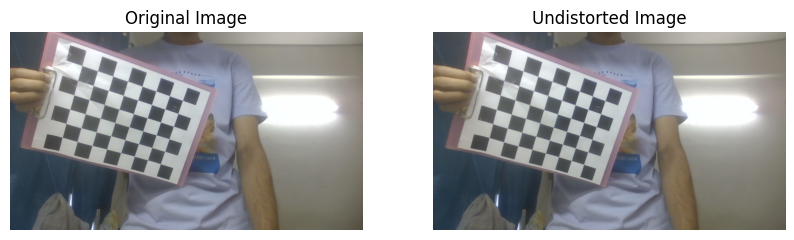

Image path: shobhit_checkerboard_patterns\11.jpg


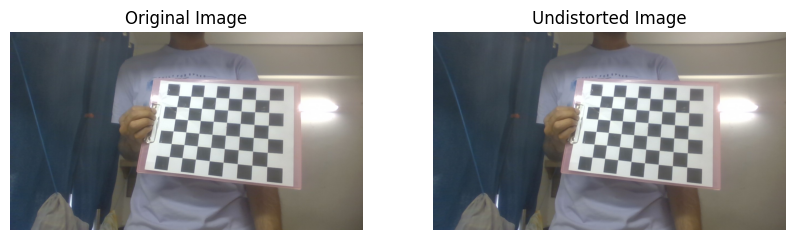

Image path: shobhit_checkerboard_patterns\12.jpg


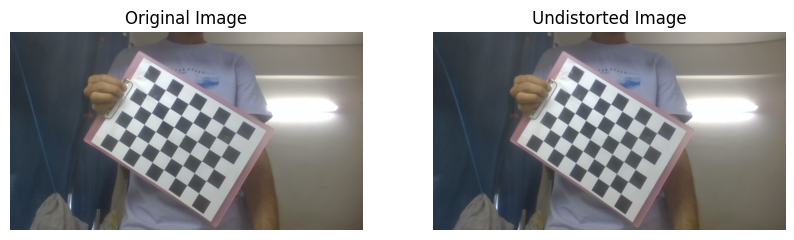

Image path: shobhit_checkerboard_patterns\13.jpg


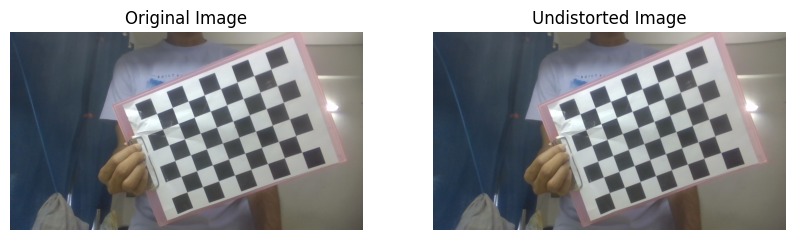

Image path: shobhit_checkerboard_patterns\14.jpg


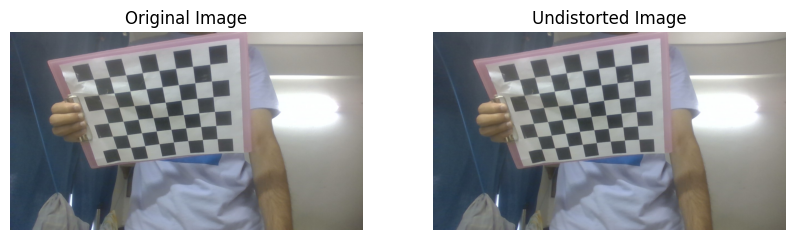

Image path: shobhit_checkerboard_patterns\15.jpg


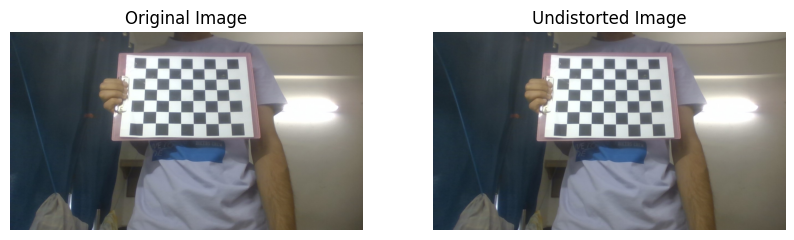

Image path: shobhit_checkerboard_patterns\16.jpg


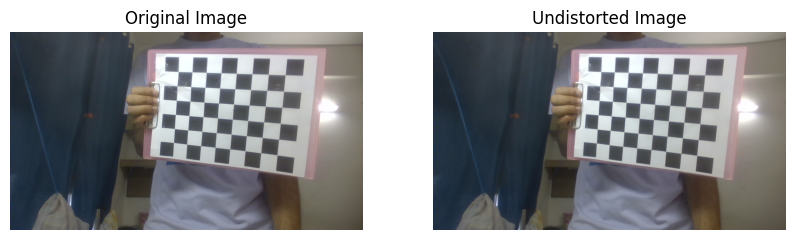

Image path: shobhit_checkerboard_patterns\17.jpg


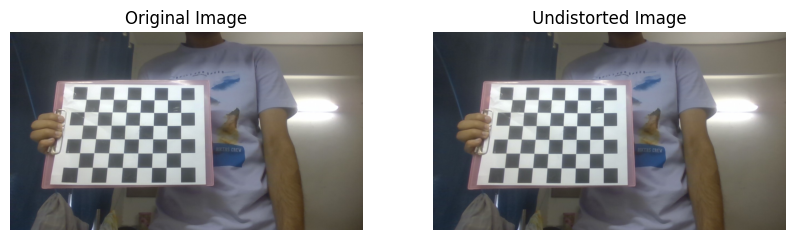

Image path: shobhit_checkerboard_patterns\18.jpg


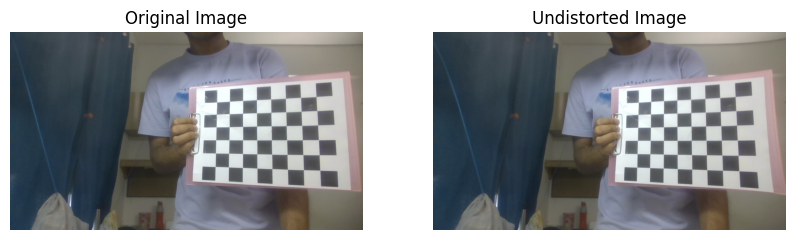

Image path: shobhit_checkerboard_patterns\19.jpg


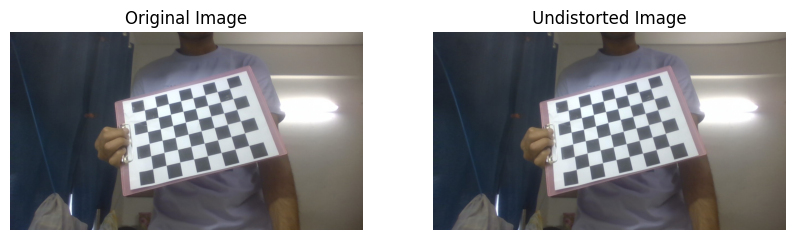

Image path: shobhit_checkerboard_patterns\20.jpg


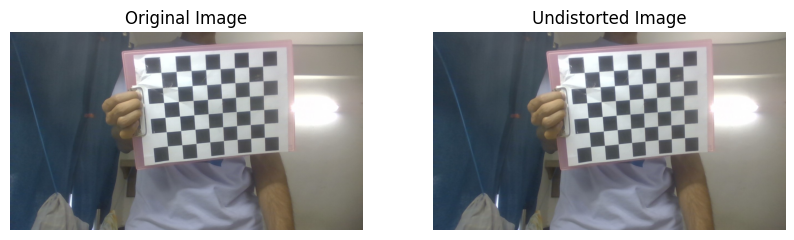

Image path: shobhit_checkerboard_patterns\21.jpg


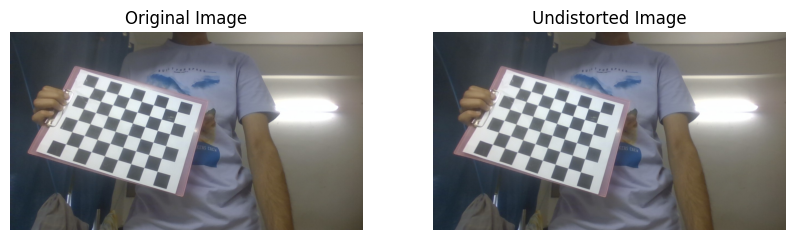

Image path: shobhit_checkerboard_patterns\22.jpg


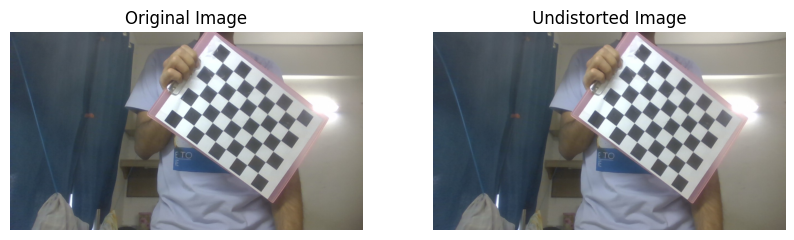

Image path: shobhit_checkerboard_patterns\23.jpg


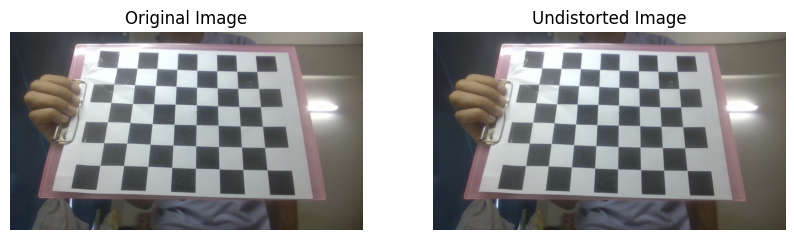

Image path: shobhit_checkerboard_patterns\24.jpg


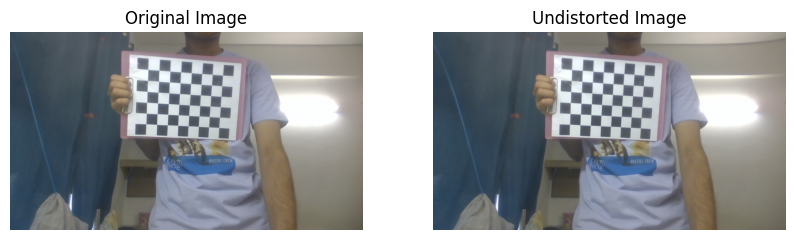

Image path: shobhit_checkerboard_patterns\25.jpg


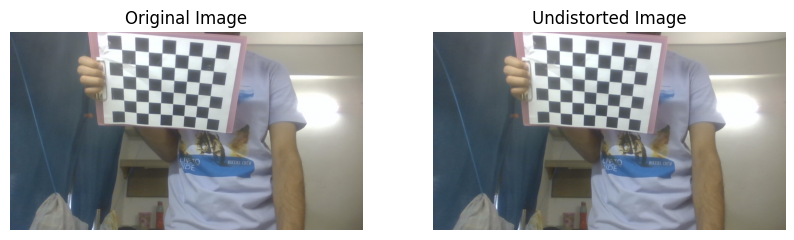

In [7]:
# Given dataset
print("\nRadial distortion coefficients for given dataset:")
print(f"k1: {radial_distortion_coefficients[0]}")
print(f"k2: {radial_distortion_coefficients[1]}")
print(f"k3: {radial_distortion_coefficients[2]}")

# My camera dataset
print("\nRadial distortion coefficients for my camera dataset:")
print(f"k1: {my_camera_radial_distortion_coefficients[0]}")
print(f"k2: {my_camera_radial_distortion_coefficients[1]}")
print(f"k3: {my_camera_radial_distortion_coefficients[2]}")

print()

def ques3_part3_undistort_images(camera_matrix, distortion_coefficients, path):
    images_path = sorted(glob.glob(path), key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('_')[-1]))

    for idx, image_path in enumerate(images_path):
        print(f"Image path: {image_path}")
        image = cv2.imread(image_path)
        h, w = image.shape[:2]
        
        new_camera_matrix, roi = cv2.getOptimalNewCameraMatrix(camera_matrix, distortion_coefficients, (w, h), 0, (w, h))
        undistorted_image = cv2.undistort(image, camera_matrix, distortion_coefficients, None, new_camera_matrix)
        
        x, y, w, h = roi
        undistorted_image = undistorted_image[y:y+h, x:x+w]
        
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.title(f"Original Image")
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.title(f"Undistorted Image")
        plt.imshow(cv2.cvtColor(undistorted_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()


# Given dataset
ques3_part3_undistort_images(camera_matrix, distortion_coefficients, 'chessboard_dataset/*.jpeg')

# My camera dataset
ques3_part3_undistort_images(my_camera_camera_matrix, my_camera_distortion_coefficients, 'shobhit_checkerboard_patterns/*.jpg')

Part 4

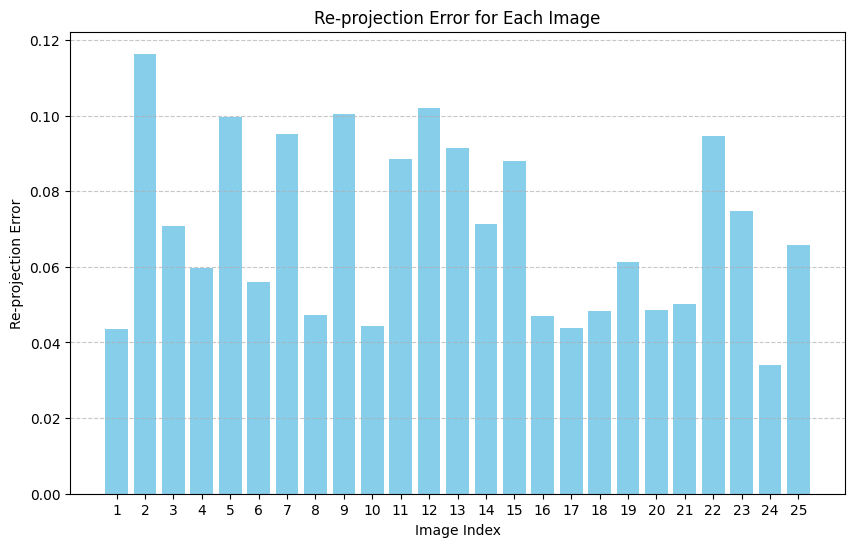

Mean reprojection error: 0.06971439945721061
Standard deviation of reprojection error: 0.0232137908988232


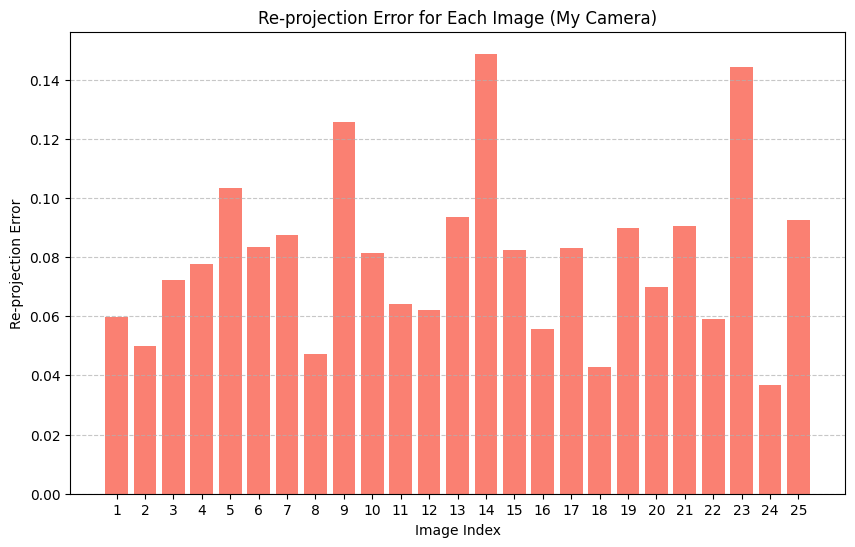

Mean reprojection error: 0.08016655510531397
Standard deviation of reprojection error: 0.0279125166878781


In [8]:
# Given dataset
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(errors) + 1), errors, color='skyblue')
plt.xlabel('Image Index')
plt.ylabel('Re-projection Error')
plt.title('Re-projection Error for Each Image')
plt.xticks(range(1, len(errors) + 1))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


mean_error = reprojection_errors["mean_error"]
std_dev = reprojection_errors["std_dev"]
print(f"Mean reprojection error: {mean_error}")
print(f"Standard deviation of reprojection error: {std_dev}")

# My camera dataset
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(my_camera_errors) + 1), my_camera_errors, color='salmon')
plt.xlabel('Image Index')
plt.ylabel('Re-projection Error')
plt.title('Re-projection Error for Each Image (My Camera)')
plt.xticks(range(1, len(my_camera_errors) + 1))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

mean_error = my_camera_reprojection_errors["mean_error"]
std_dev = my_camera_reprojection_errors["std_dev"]
print(f"Mean reprojection error: {mean_error}")
print(f"Standard deviation of reprojection error: {std_dev}")

Part 5

Image path: chessboard_dataset\1.jpeg


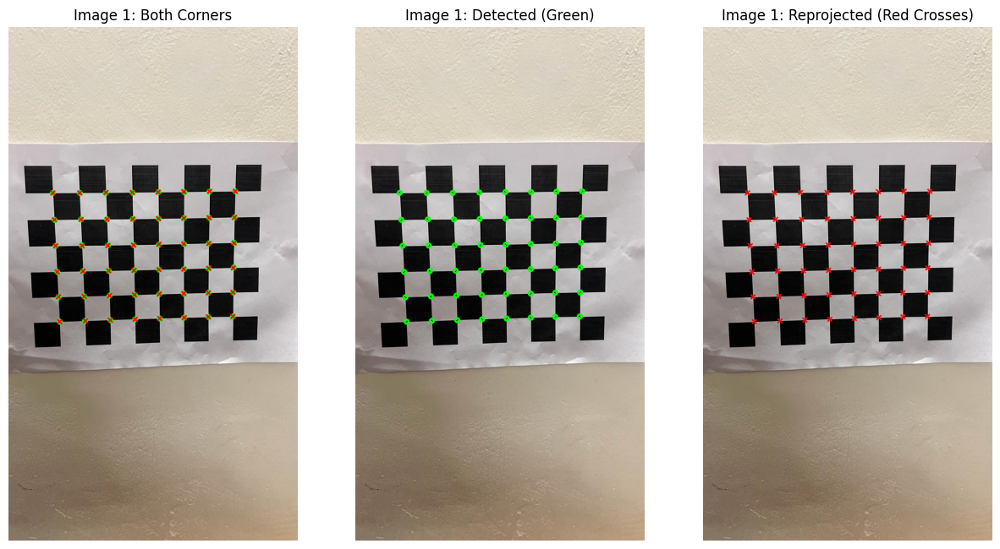

Image path: chessboard_dataset\2.jpeg


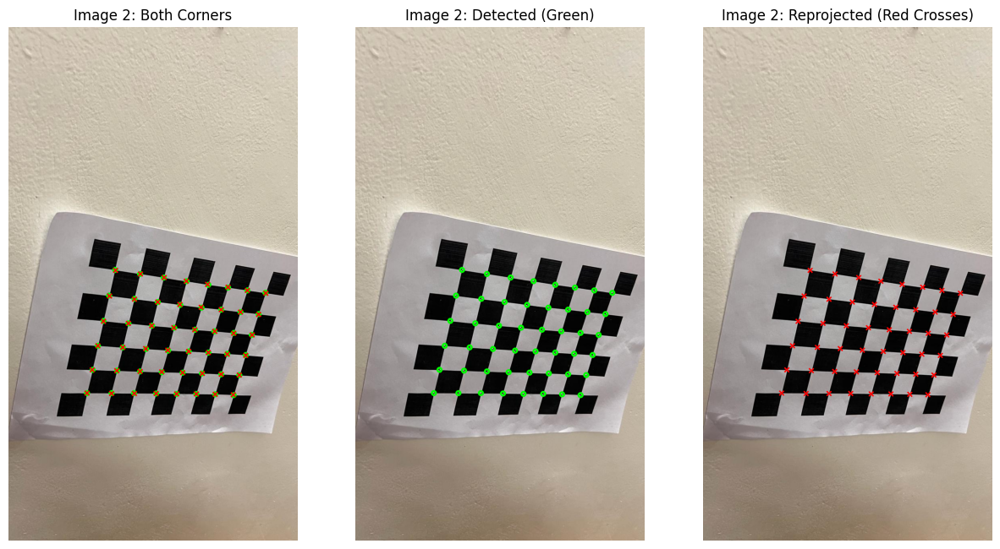

Image path: chessboard_dataset\3.jpeg


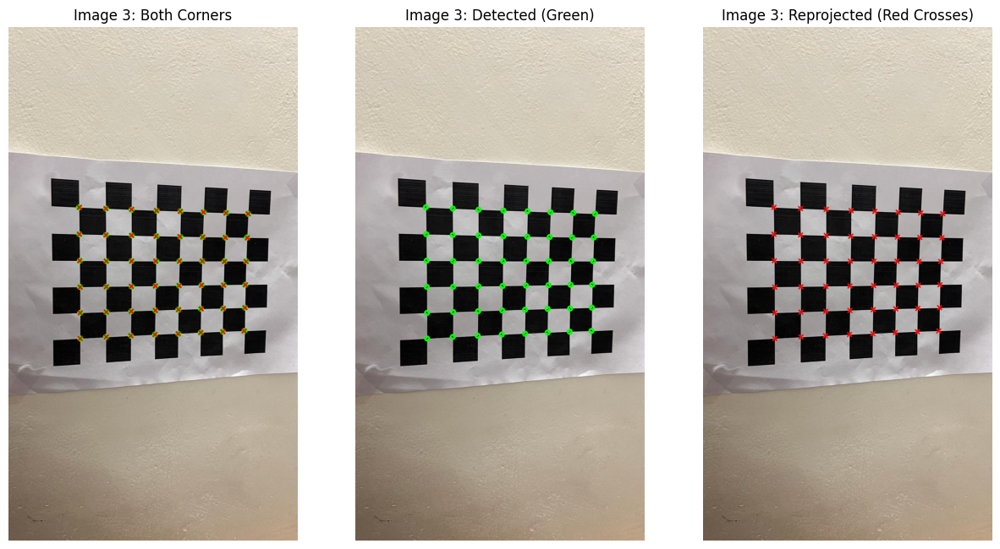

Image path: chessboard_dataset\4.jpeg


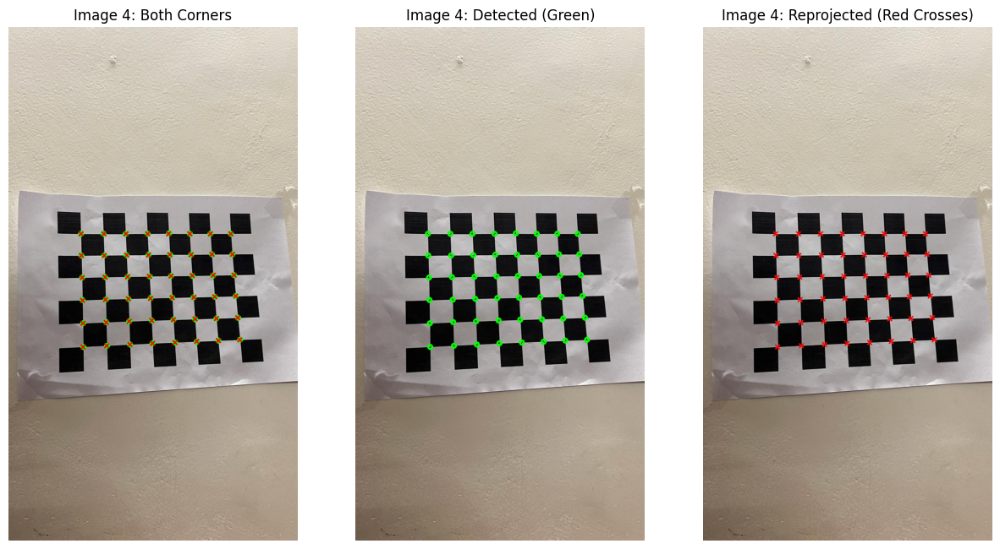

Image path: chessboard_dataset\5.jpeg


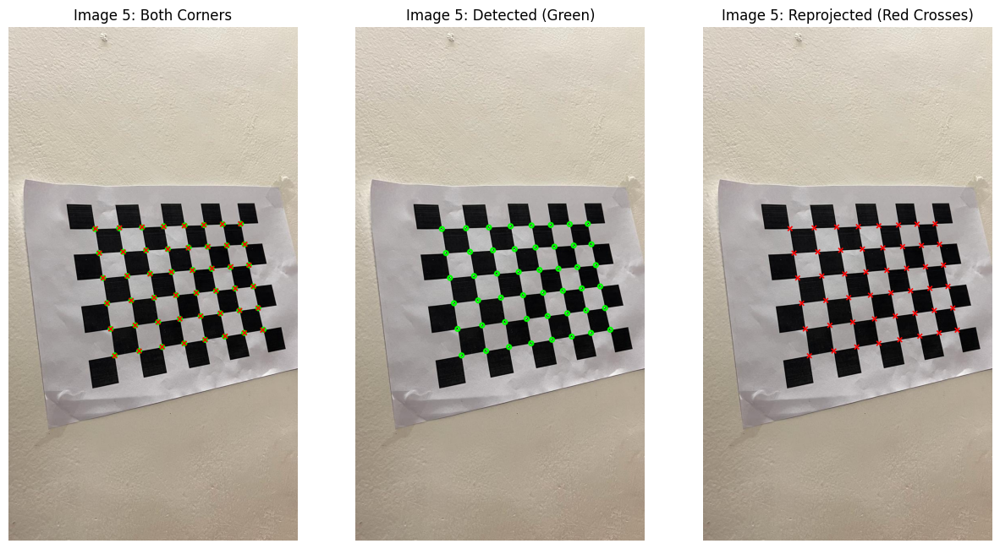

Image path: chessboard_dataset\6.jpeg


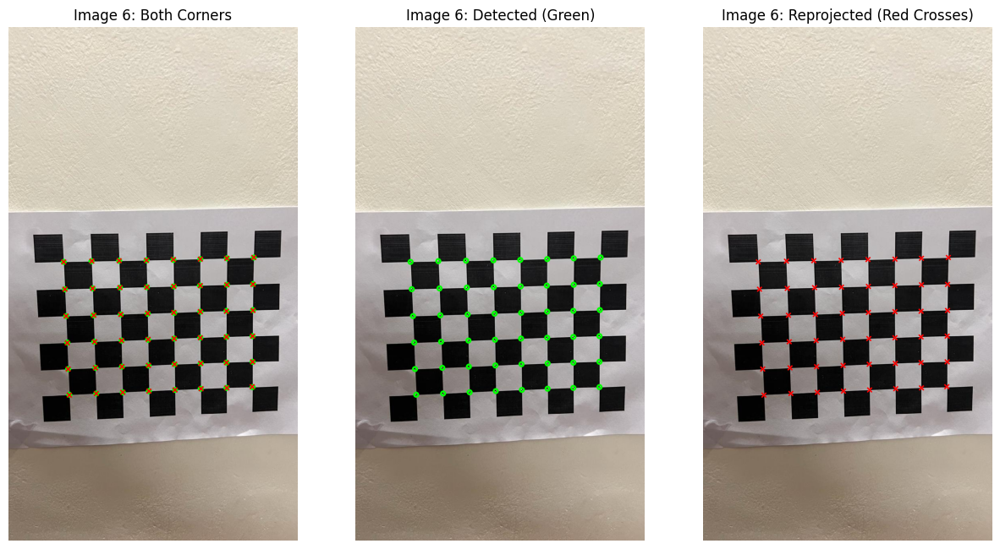

Image path: chessboard_dataset\7.jpeg


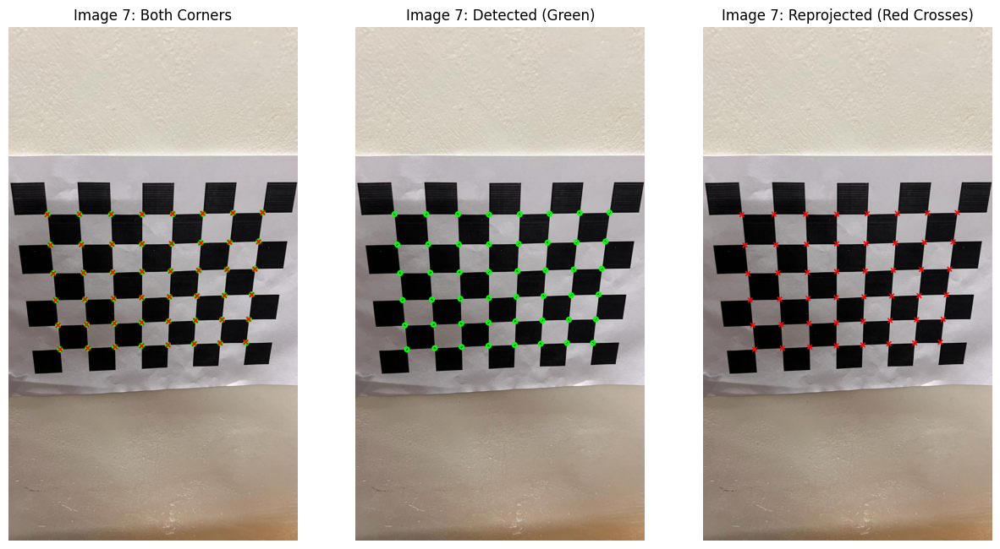

Image path: chessboard_dataset\8.jpeg


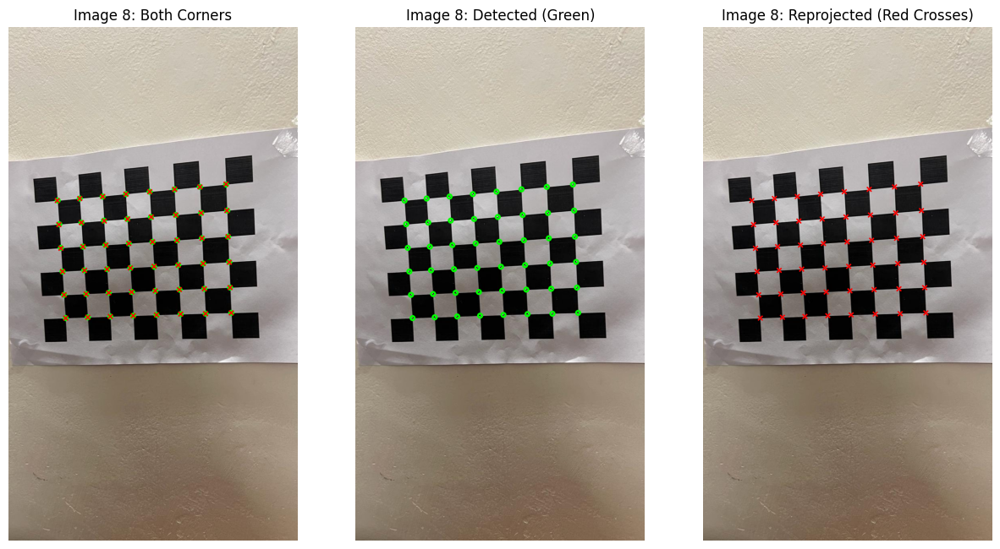

Image path: chessboard_dataset\9.jpeg


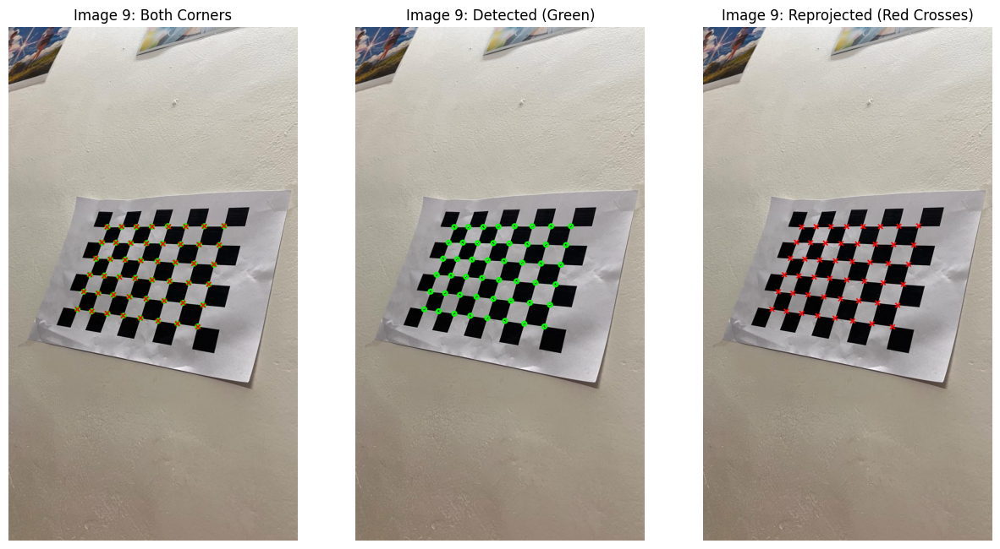

Image path: chessboard_dataset\10.jpeg


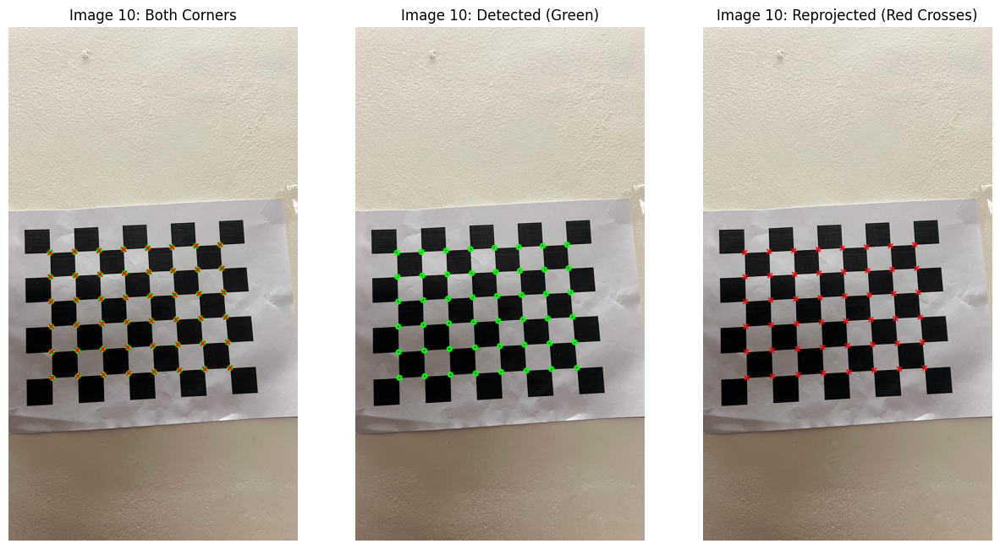

Image path: chessboard_dataset\11.jpeg


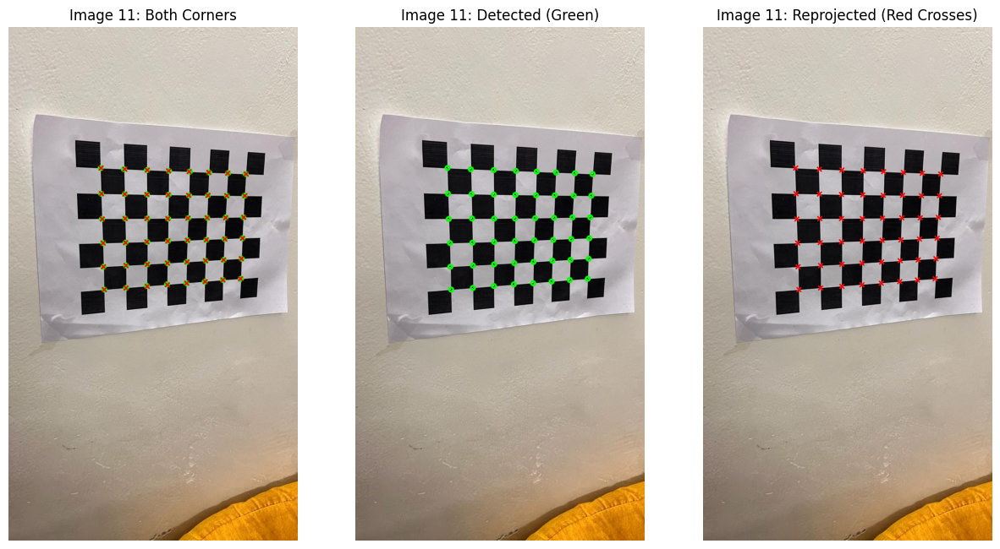

Image path: chessboard_dataset\12.jpeg


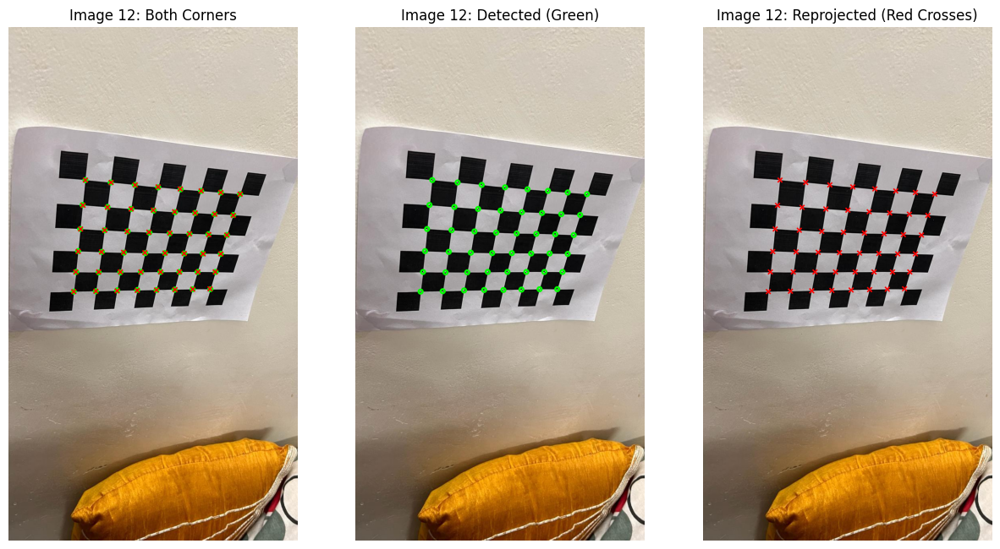

Image path: chessboard_dataset\13.jpeg


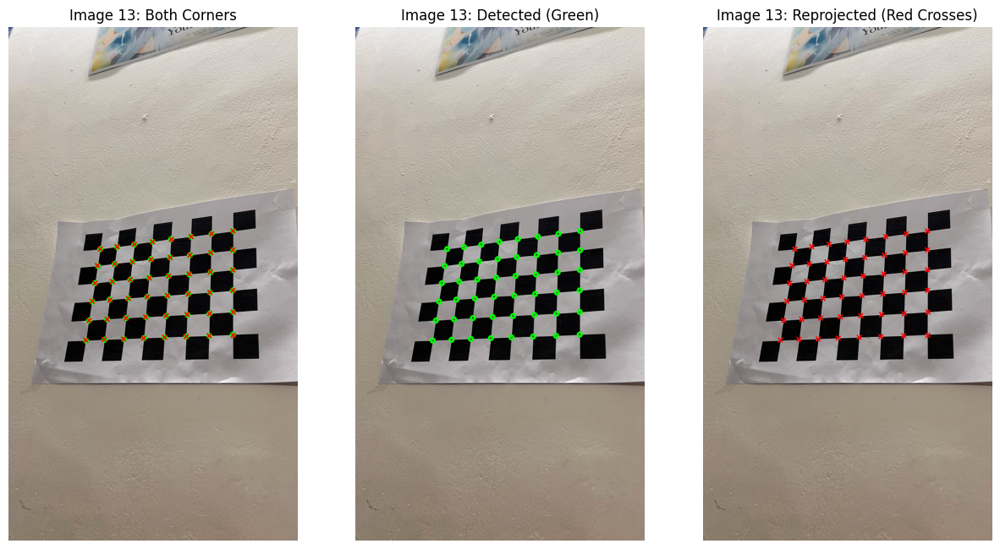

Image path: chessboard_dataset\14.jpeg


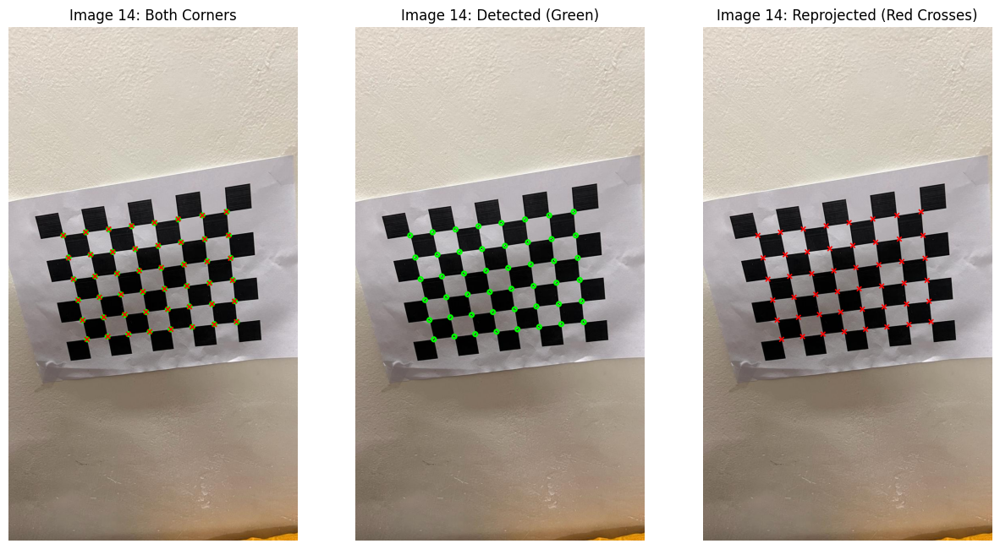

Image path: chessboard_dataset\15.jpeg


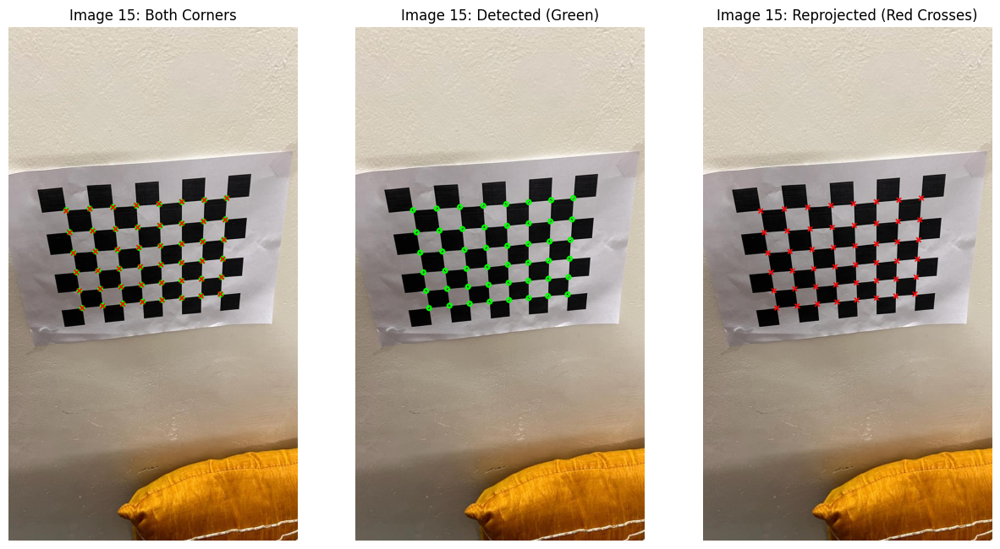

Image path: chessboard_dataset\16.jpeg


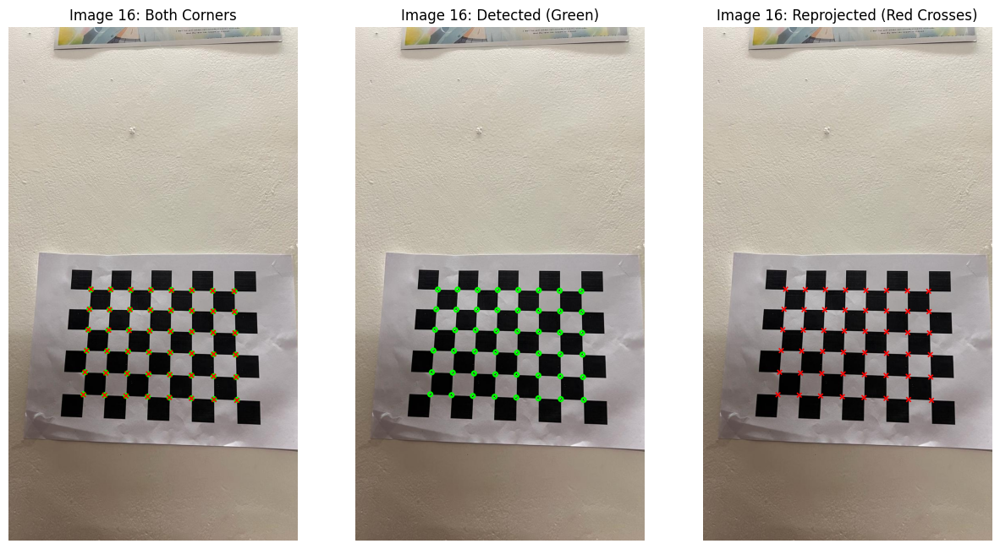

Image path: chessboard_dataset\17.jpeg


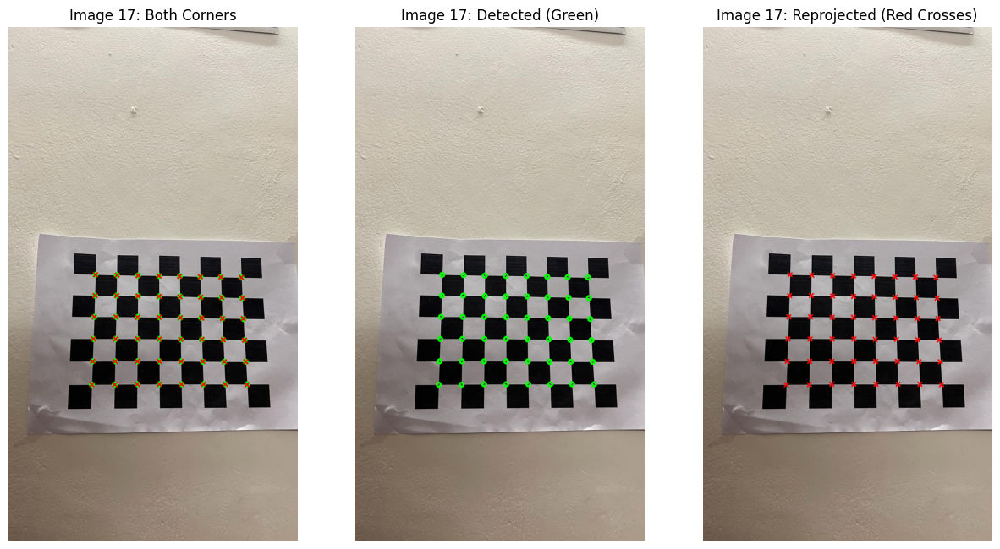

Image path: chessboard_dataset\18.jpeg


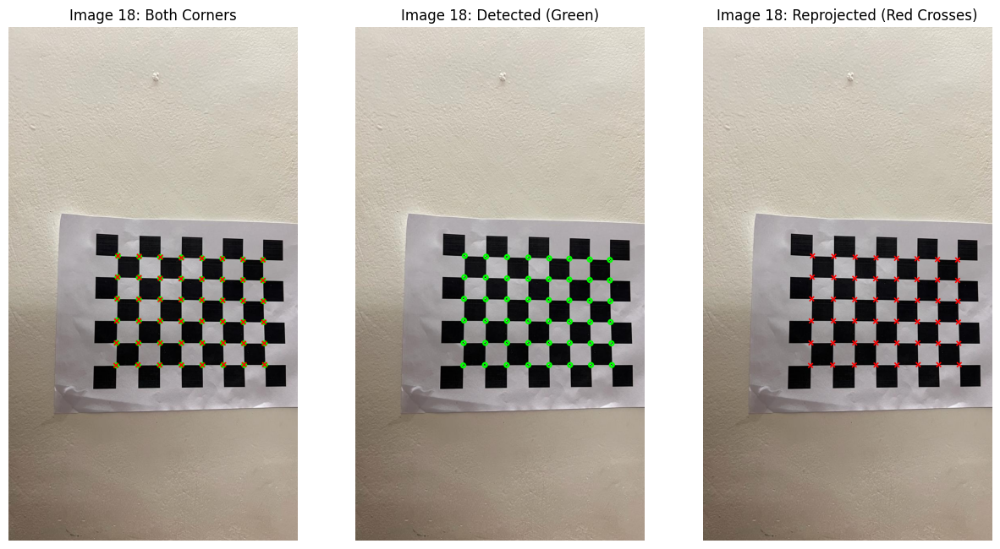

Image path: chessboard_dataset\19.jpeg


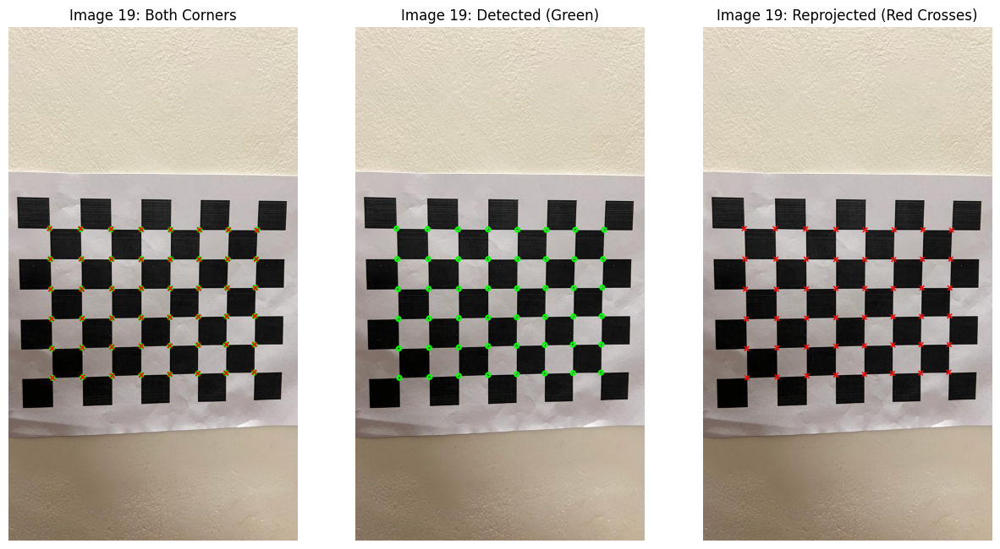

Image path: chessboard_dataset\20.jpeg


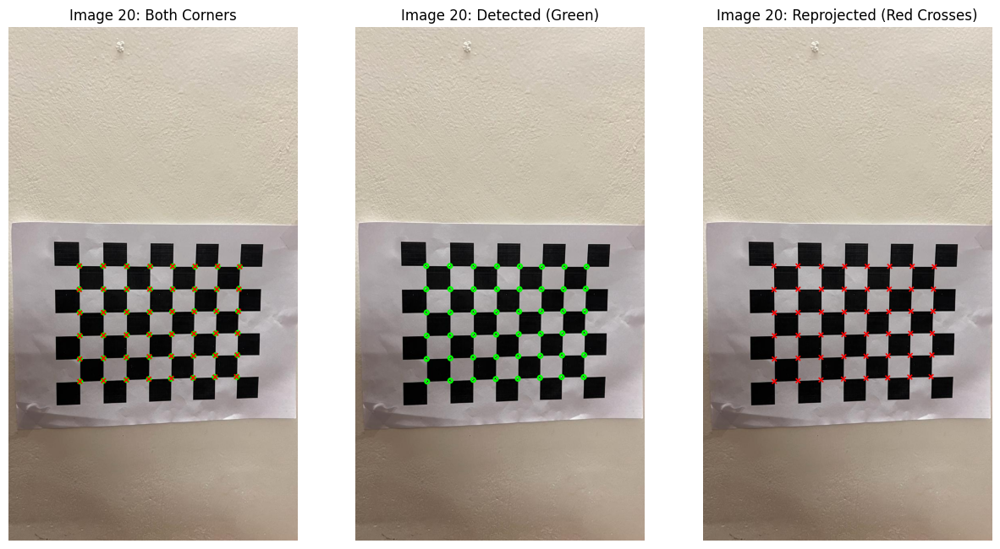

Image path: chessboard_dataset\21.jpeg


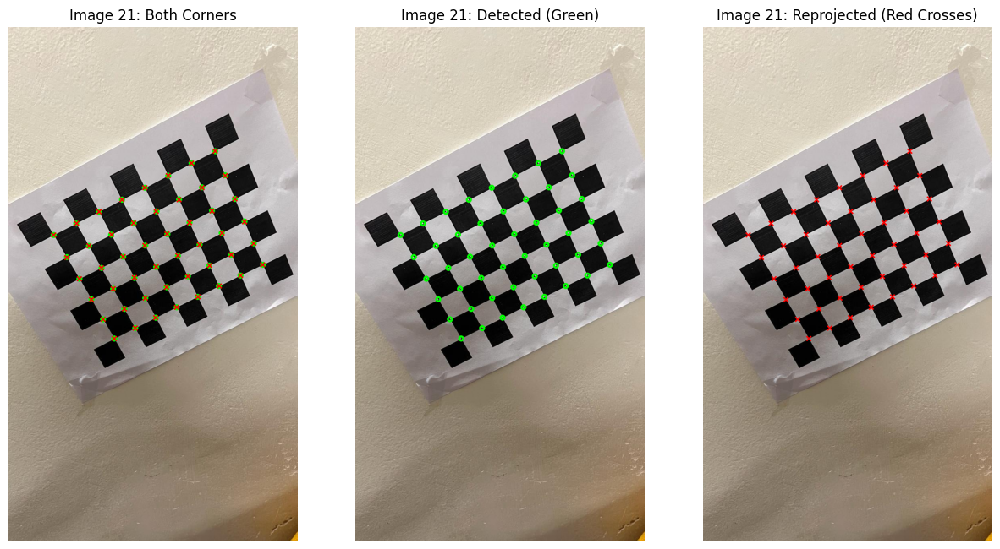

Image path: chessboard_dataset\22.jpeg


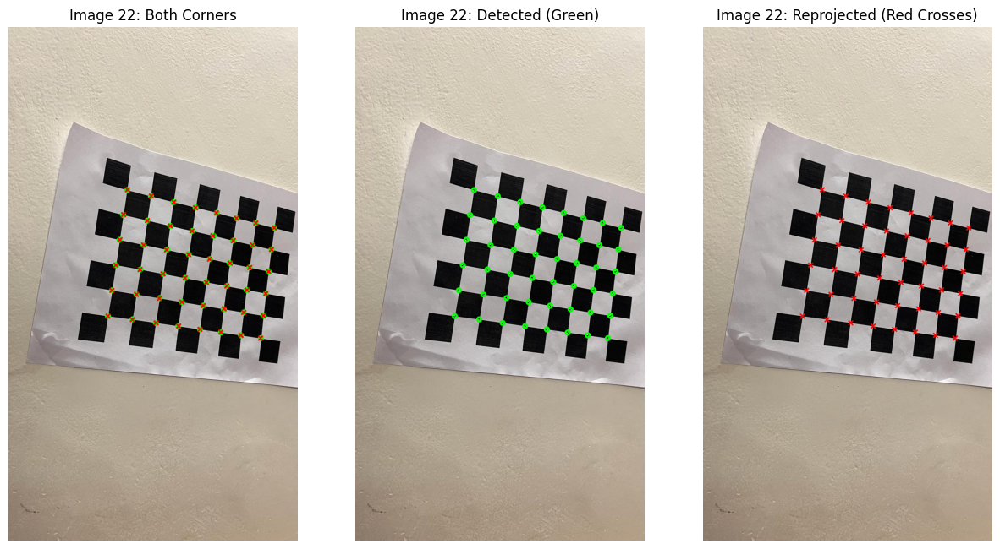

Image path: chessboard_dataset\23.jpeg


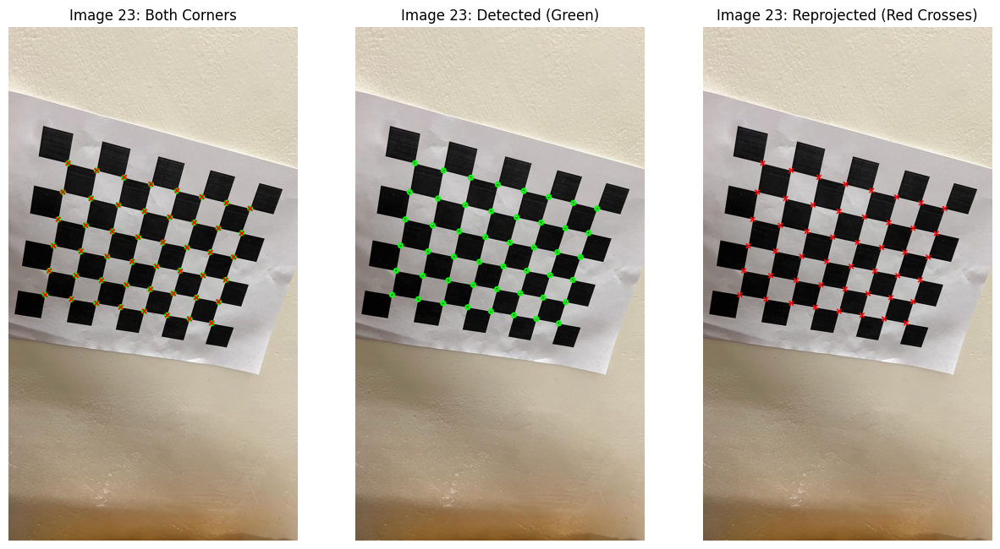

Image path: chessboard_dataset\24.jpeg


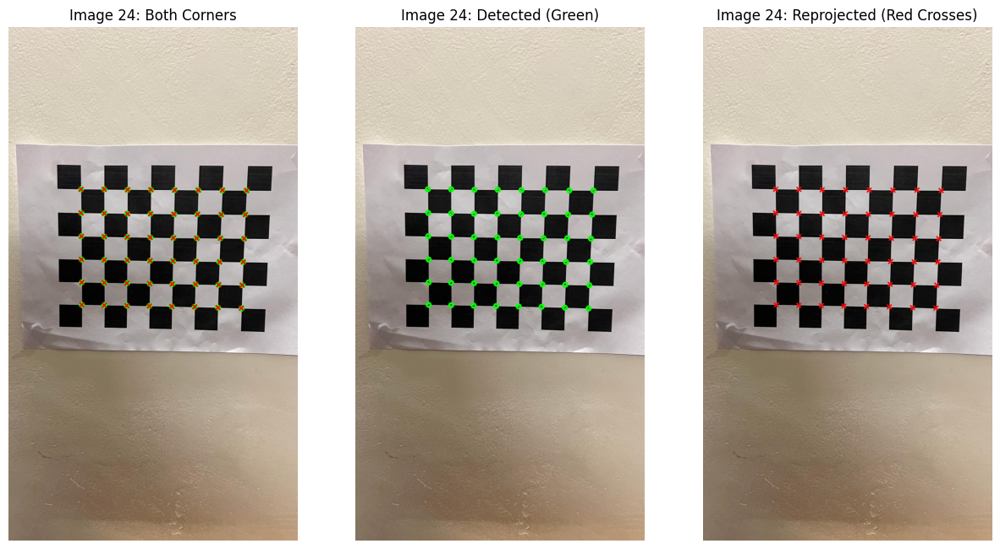

Image path: chessboard_dataset\25.jpeg


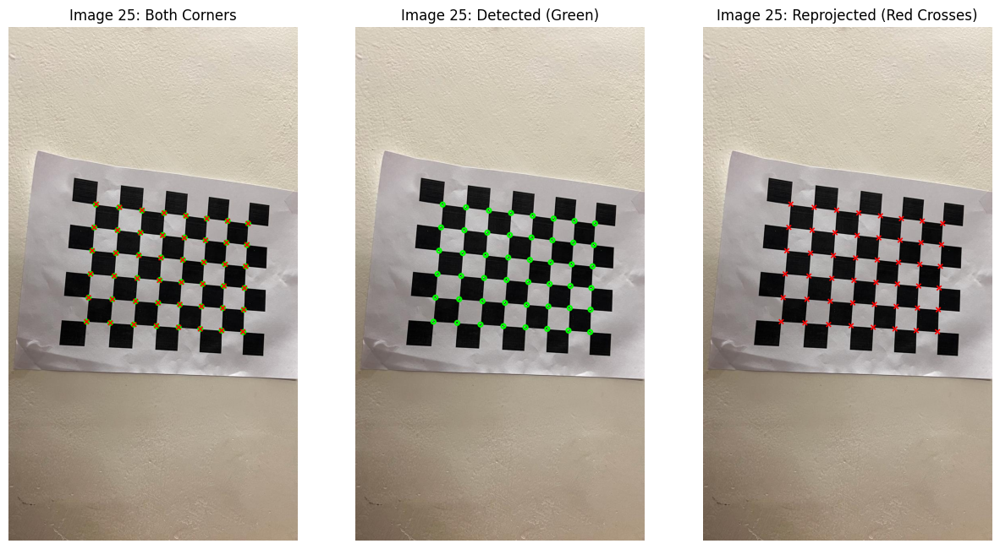

Image path: shobhit_checkerboard_patterns\1.jpg


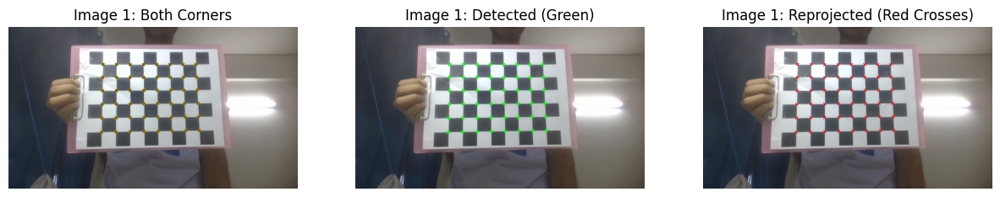

Image path: shobhit_checkerboard_patterns\2.jpg


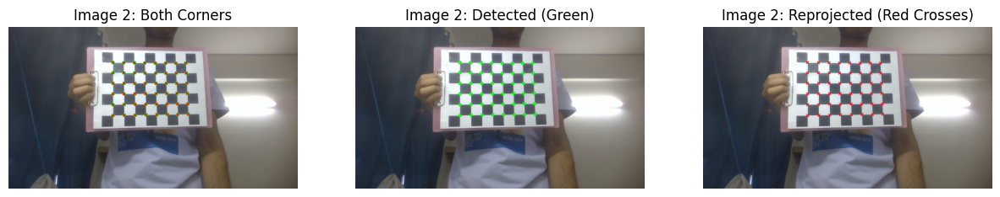

Image path: shobhit_checkerboard_patterns\3.jpg


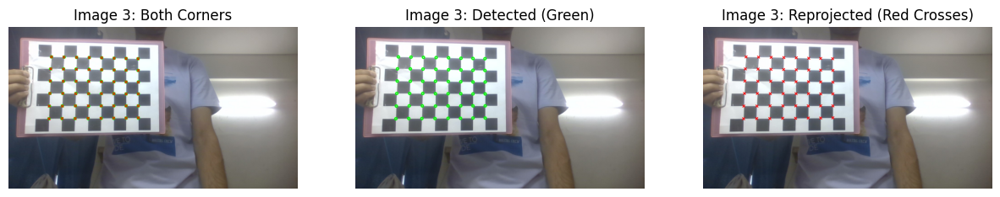

Image path: shobhit_checkerboard_patterns\4.jpg


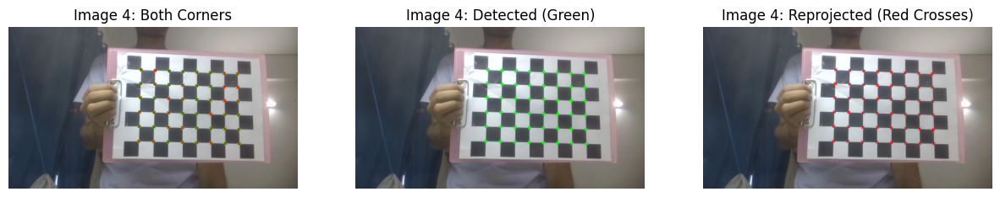

Image path: shobhit_checkerboard_patterns\5.jpg


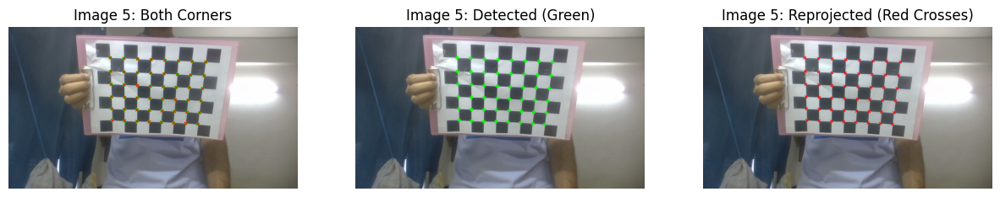

Image path: shobhit_checkerboard_patterns\6.jpg


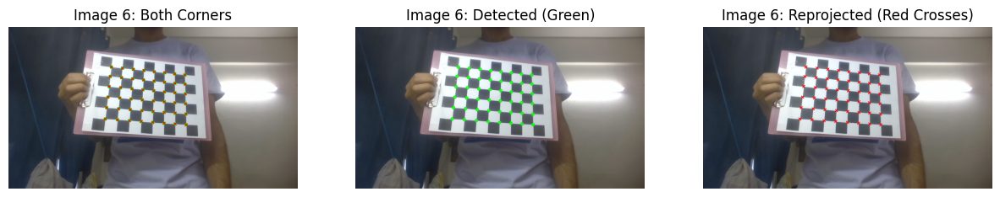

Image path: shobhit_checkerboard_patterns\7.jpg


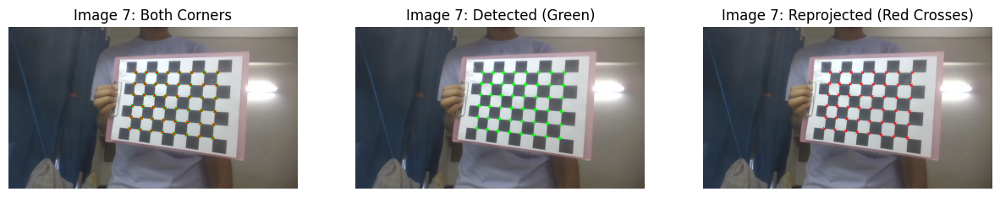

Image path: shobhit_checkerboard_patterns\8.jpg


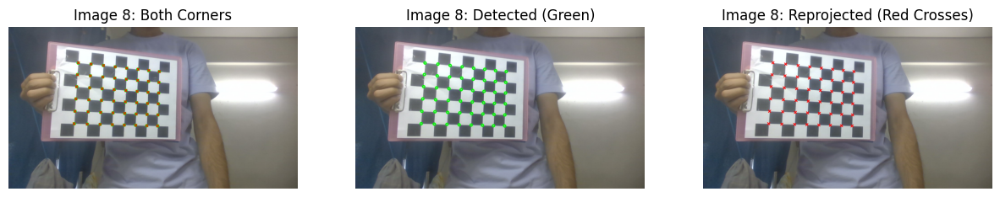

Image path: shobhit_checkerboard_patterns\9.jpg


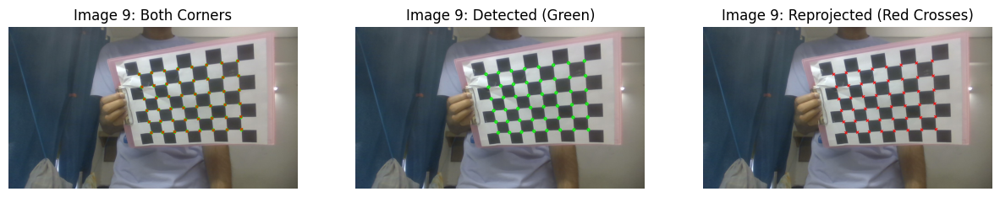

Image path: shobhit_checkerboard_patterns\10.jpg


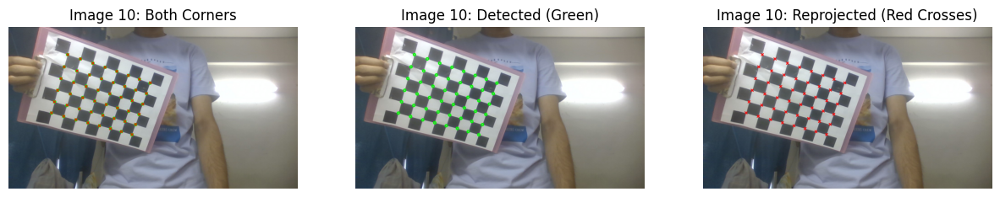

Image path: shobhit_checkerboard_patterns\11.jpg


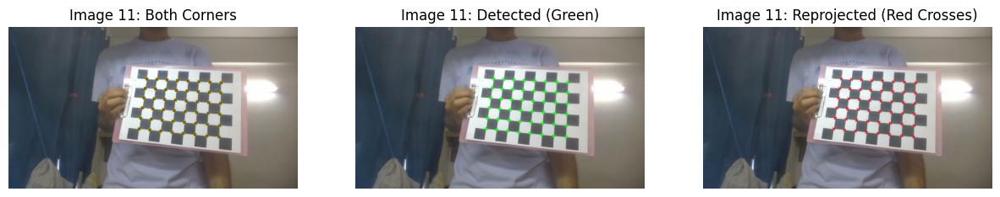

Image path: shobhit_checkerboard_patterns\12.jpg


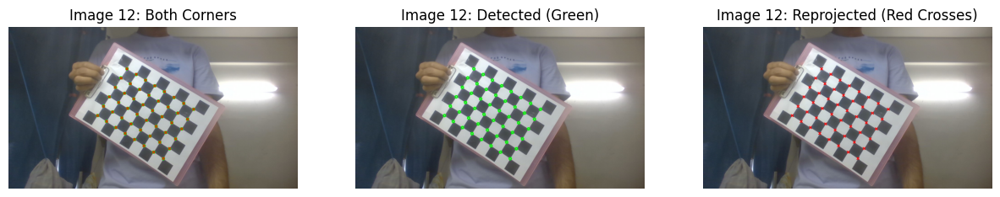

Image path: shobhit_checkerboard_patterns\13.jpg


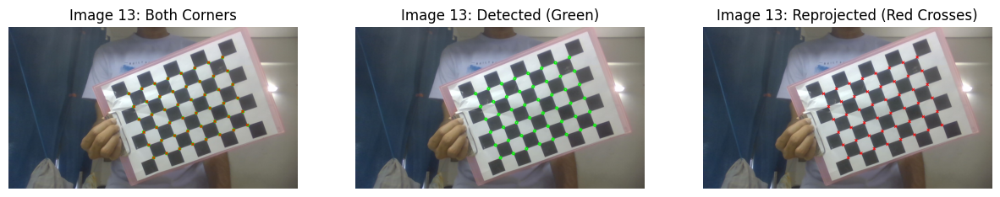

Image path: shobhit_checkerboard_patterns\14.jpg


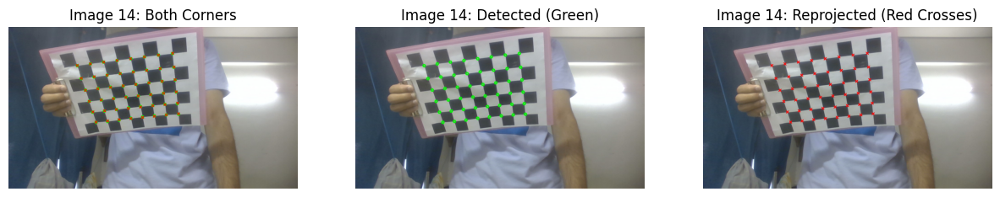

Image path: shobhit_checkerboard_patterns\15.jpg


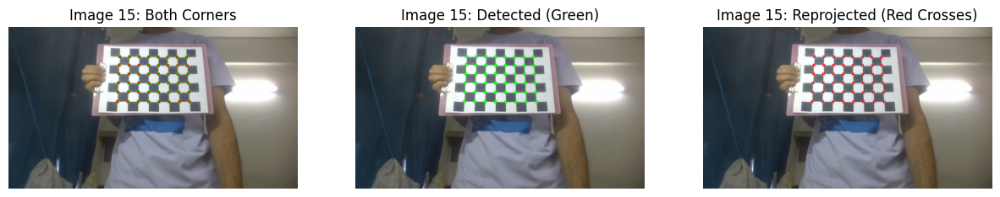

Image path: shobhit_checkerboard_patterns\16.jpg


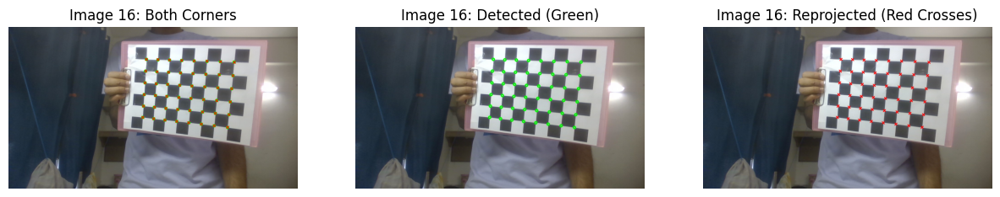

Image path: shobhit_checkerboard_patterns\17.jpg


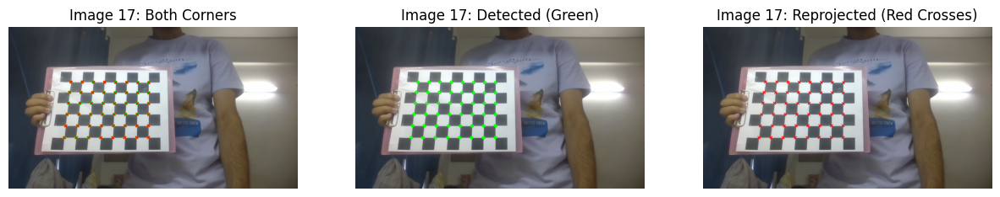

Image path: shobhit_checkerboard_patterns\18.jpg


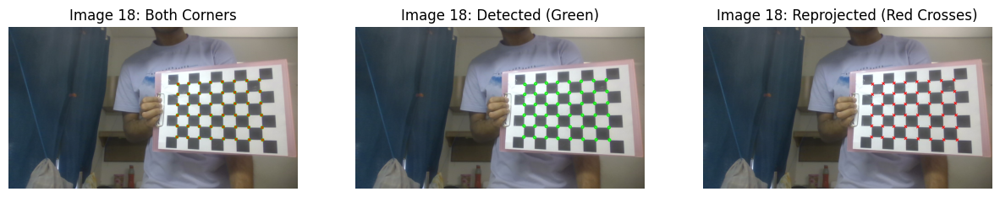

Image path: shobhit_checkerboard_patterns\19.jpg


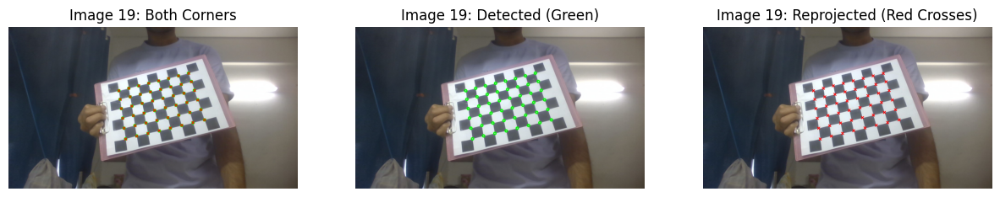

Image path: shobhit_checkerboard_patterns\20.jpg


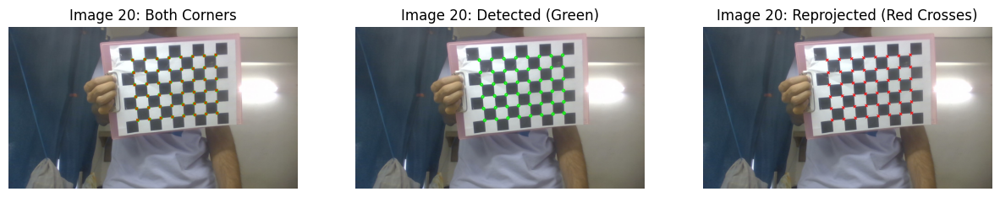

Image path: shobhit_checkerboard_patterns\21.jpg


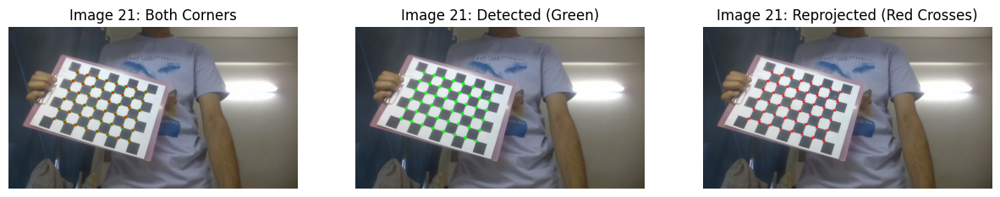

Image path: shobhit_checkerboard_patterns\22.jpg


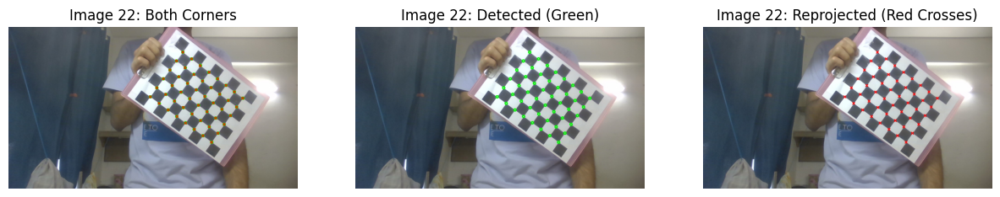

Image path: shobhit_checkerboard_patterns\23.jpg


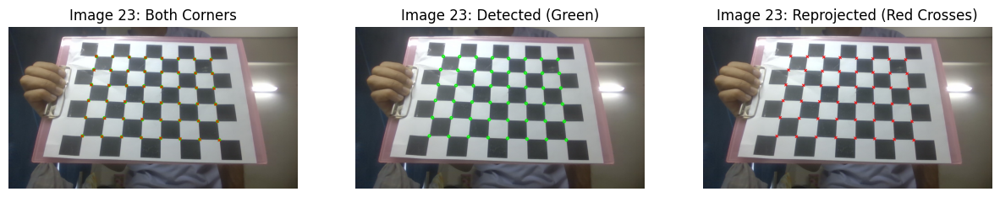

Image path: shobhit_checkerboard_patterns\24.jpg


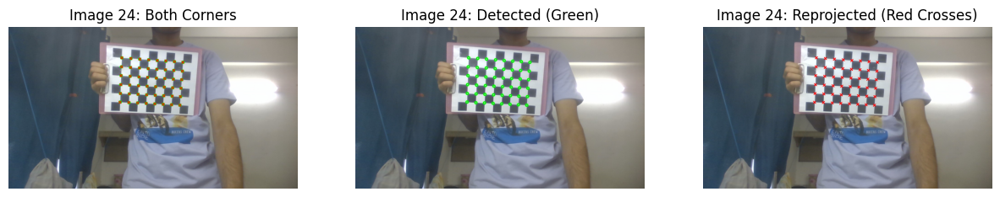

Image path: shobhit_checkerboard_patterns\25.jpg


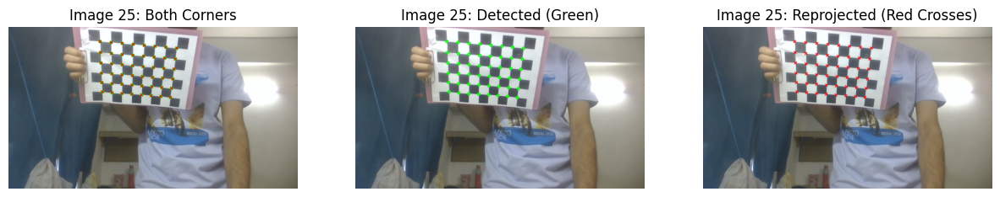

In [9]:
def ques3_part5_reprojected_images(imagePoints, imageProjPoints, images_path):
    images_path = sorted(glob.glob(images_path), key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('_')[-1]))
    for i in range(len(imagePoints)):    
        print(f"Image path: {images_path[i]}")
        img_original = cv2.imread(images_path[i])
        
        img_combined = img_original.copy()  
        img_reprojected = img_original.copy()  
        img_detected = img_original.copy()  

        for j in range(len(imagePoints[i])):
            point = tuple(imagePoints[i][j][0].astype(int))
            cv2.circle(img_combined, point, 5, (0, 255, 0), 3)
            cv2.circle(img_detected, point, 5, (0, 255, 0), 3)

        cross_size = 5 
        for j in range(len(imageProjPoints[i])):
            x, y = imageProjPoints[i][j][0].astype(int)
            cv2.line(img_combined, (x - cross_size, y - cross_size), (x + cross_size, y + cross_size), (0, 0, 255), 2)
            cv2.line(img_combined, (x - cross_size, y + cross_size), (x + cross_size, y - cross_size), (0, 0, 255), 2)
            cv2.line(img_reprojected, (x - cross_size, y - cross_size), (x + cross_size, y + cross_size), (0, 0, 255), 2)
            cv2.line(img_reprojected, (x - cross_size, y + cross_size), (x + cross_size, y - cross_size), (0, 0, 255), 2)

        img_combined = cv2.cvtColor(img_combined, cv2.COLOR_BGR2RGB)
        img_reprojected = cv2.cvtColor(img_reprojected, cv2.COLOR_BGR2RGB)
        img_detected = cv2.cvtColor(img_detected, cv2.COLOR_BGR2RGB)

        fig, axes = plt.subplots(1, 3, figsize=(15, 12))

        axes[0].imshow(img_combined)
        axes[0].set_title(f"Image {i+1}: Both Corners")
        axes[0].axis("off")

        axes[1].imshow(img_detected)
        axes[1].set_title(f"Image {i+1}: Detected (Green)")
        axes[1].axis("off")

        axes[2].imshow(img_reprojected)
        axes[2].set_title(f"Image {i+1}: Reprojected (Red Crosses)")
        axes[2].axis("off")

        plt.show()

# Given dataset
ques3_part5_reprojected_images(imagePoints, imageProjPoints, 'chessboard_dataset/*.jpeg')

# My camera dataset
ques3_part5_reprojected_images(my_camera_imagePoints, my_camera_imageProjPoints, 'shobhit_checkerboard_patterns/*.jpg')

Part 6

In [10]:
def ques3_part6_plane_normals(extrinsic_parameters):
    plane_normals = []
    for extrinsic in extrinsic_parameters:
        rotation_matrix = extrinsic["rotation_matrix"]
        normal_world = np.array([0, 0, 1])  # (z-axis)
        rotation_matrix = np.array(rotation_matrix).reshape(3, 3)
        normal_camera = np.dot(rotation_matrix, normal_world)
        plane_normals.append(normal_camera)
    return plane_normals

# Given dataset
plane_normals_given = ques3_part6_plane_normals(extrinsic_parameters)
print("Checkerboard plane normals for the given dataset:")
for i, normal in enumerate(plane_normals_given):
    print(f"Image {i+1}: {normal}")

# My camera dataset
plane_normals_my_camera = ques3_part6_plane_normals(my_camera_extrinsic_parameters)
print("\nCheckerboard plane normals for my camera dataset:")
for i, normal in enumerate(plane_normals_my_camera):
    print(f"Image {i+1}: {normal}")

Checkerboard plane normals for the given dataset:
Image 1: [-0.0761683  -0.14870443  0.9859439 ]
Image 2: [-0.38526818 -0.30920821  0.86945886]
Image 3: [-0.27140228 -0.09615201  0.95765108]
Image 4: [-0.16581684  0.16012457  0.97306983]
Image 5: [-0.39737417  0.19080494  0.89760083]
Image 6: [-0.08327303 -0.12752645  0.98833325]
Image 7: [-0.10314608 -0.40167045  0.909957  ]
Image 8: [ 0.18876584 -0.06635959  0.97977745]
Image 9: [0.45456231 0.40009243 0.79580095]
Image 10: [-0.0228698   0.12383015  0.99203985]
Image 11: [-0.39826967 -0.18715469  0.89797238]
Image 12: [-0.34643453 -0.5281008   0.77530166]
Image 13: [0.35820576 0.39861417 0.8442721 ]
Image 14: [ 0.04521853 -0.32517343  0.94457267]
Image 15: [-0.12778898 -0.50726445  0.85226331]
Image 16: [0.07201336 0.21723429 0.97345947]
Image 17: [-0.09543046  0.19721067  0.97570537]
Image 18: [-0.14608072  0.07386587  0.98651115]
Image 19: [-0.1077335  -0.08642536  0.99041615]
Image 20: [-0.13551125 -0.10599322  0.98508991]
Image 21